#**Image-to-Image Translation Using Conditional DCGANs !!!**

This notebook contain the implemented "Image-to-Image Translation Using Conditional DCGANs" based on the paper called "Image-to-Image Translation with Conditional Adversarial Networks"

L1 loss has been used in the loss function


In [0]:
from google.colab import files

uploaded = files.upload()

!mkdir ~/.kaggle
!cp /content/kaggle.json ~/.kaggle/kaggle.json

!kaggle datasets download -d vikramtiwari/pix2pix-dataset
!unzip \*.zip  && rm *.zip
!apt-get install tree

In [0]:
!tree -d edges2shoes/

edges2shoes/
└── edges2shoes
    ├── train
    └── val

3 directories


In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
import os,shutil
import pandas as pd
import torch
import numpy as np
from torch import nn
from torchsummary import summary
import torchvision
from torchvision import datasets
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.utils import make_grid

device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Create DataLoaders

In [0]:
class get_dataset(torch.utils.data.Dataset):
  def __init__(self,name='edges2shoes',type_='train',transform=None):
    self.dir_=name+'/'+name+'/'+type_
    self.img_list=sorted(os.listdir(self.dir_))
    self.transform=transform
  def __len__(self):
    return len(self.img_list)
  def __getitem__(self,idx):
    both=plt.imread(self.dir_+'/'+self.img_list[idx]).astype('uint8')
    x=both[:,:both.shape[1]//2,:]
    y=both[:,both.shape[1]//2:,:]
    x,y=self.transform(Image.fromarray(x)),self.transform(Image.fromarray(y))
    return x,y    

In [0]:
img_size=128
batch_size=32

my_transform=transforms.Compose([transforms.Resize((img_size,img_size)),transforms.ToTensor()])
dataset_edges2shoes=get_dataset(name='edges2shoes',transform=my_transform)

dataloader=torch.utils.data.DataLoader(dataset_edges2shoes,batch_size=batch_size,shuffle=True,drop_last=True)

## Create the Model Architecture



In [0]:
class conv_block(nn.Module):
  def __init__(self,in_channels,out_channels,kernel_size=4,stride=2,padding=1):
    super(conv_block,self).__init__()
    self.conv_block=nn.Sequential(
        nn.Conv2d(in_channels,out_channels,kernel_size,stride,padding),
        nn.LeakyReLU(0.2),
        nn.BatchNorm2d(out_channels)
    )  
  def forward(self,x):
    return self.conv_block(x)

class transconv_block(nn.Module):
  def __init__(self,in_channels,out_channels,kernel_size=4,stride=2,padding=1):
    super(transconv_block,self).__init__()
    self.transconv_block=nn.Sequential(
        nn.ConvTranspose2d(in_channels,out_channels,kernel_size,stride,padding),
        nn.ReLU(),
        nn.BatchNorm2d(out_channels)
    )
  def forward(self,x):
    return self.transconv_block(x)

###1. Generator

In [0]:
# for 128,128 size
class Generator(nn.Module):
  def __init__(self):
    super(Generator,self).__init__()

    self.enc_layer1=conv_block(4,8)
    self.enc_layer2=conv_block(8,16)
    self.enc_layer3=conv_block(16,32)
    self.enc_layer4=conv_block(32,64)
    self.enc_layer5=conv_block(64,128)
    self.bottleneck=conv_block(128,256,kernel_size=4,stride=1,padding=0)

    self.dec_layer1=transconv_block(256,128,kernel_size=4,stride=1,padding=0)
    self.dec_layer2=transconv_block(256,64)
    self.dec_layer3=transconv_block(128,32)
    self.dec_layer4=transconv_block(64,16)
    self.dec_layer5=transconv_block(32,8)
    self.dec_layer6=transconv_block(16,3)
    self.dec_layer7=nn.ConvTranspose2d(6,3,kernel_size=1,stride=1,padding=0)

  def forward(self,x,z):
    z=z.view(-1,1,128,128)
    x=x.view(-1,3,128,128)
    x_noisy=torch.cat([z,x],1)
    enc1=self.enc_layer1(x_noisy)
    enc2=self.enc_layer2(enc1)
    enc3=self.enc_layer3(enc2)
    enc4=self.enc_layer4(enc3)
    enc5=self.enc_layer5(enc4)
    latent=self.bottleneck(enc5)
    dec1=torch.cat([self.dec_layer1(latent),enc5],1)
    dec2=torch.cat([self.dec_layer2(dec1),enc4],1)
    dec3=torch.cat([self.dec_layer3(dec2),enc3],1)
    dec4=torch.cat([self.dec_layer4(dec3),enc2],1)
    dec5=torch.cat([self.dec_layer5(dec4),enc1],1)
    dec6=torch.cat([self.dec_layer6(dec5),x],1)
    output=self.dec_layer7(dec6)

    return output

###2. Discriminator 

In [0]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator,self).__init__()
    self.model=nn.Sequential(
        conv_block(6,8),
        conv_block(8,16),
        conv_block(16,32),
        conv_block(32,64),
        conv_block(64,128),
        nn.Conv2d(128,1,kernel_size=4,stride=1,padding=0),
        nn.Sigmoid()
    )
  def forward(self,x,y):
    x=x.view(-1,3,128,128)
    y=y.view(-1,3,128,128)
    concat=torch.cat([x,y],1)
    out=self.model(concat)
    label=out.view(-1,1)
    return label #real/fake

### Check implemented Generator and Discriminator

In [0]:
from torch.utils.tensorboard import SummaryWriter
import os,shutil
try:
  shutil.rmtree('runs')
except:pass

os.makedirs("runs", exist_ok=True)
writer_gen = SummaryWriter('runs/generator')
writer_dis = SummaryWriter('runs/discriminator')

writer_gen.add_graph(Generator(),[torch.randn((64,3,128,128)),torch.randn((64,1,128,128))])
writer_dis.add_graph(Discriminator(),[torch.randn((64,3,128,128)),torch.randn((64,3,128,128))])  #change this to discriminator

writer_gen.close()
writer_dis.close()


%load_ext tensorboard 
%tensorboard --logdir {'runs'}

##Objective Function

In [0]:
bce=nn.BCELoss().to(device)
L1=nn.L1Loss().to(device)
k=5
def criterion_G(y_hat,y):
  loss=bce(y_hat,y)+k*L1(y_hat,y)
  return loss
def criterion_D(y_hat,y):
  loss=bce(y_hat,y)
  return loss

## Initialization

In [0]:
lr=0.0002
D=Discriminator().to(device)
G=Generator().to(device)
opt_D=torch.optim.Adam(D.parameters(),lr=lr)
opt_G=torch.optim.Adam(G.parameters(),lr=lr)
losses_G,losses_D=[],[]

##Load Previously saved models

In [0]:
def load_checkpoint(G,D,losses_G,losses_D):
  G.load_state_dict(torch.load('gdrive/My Drive/pix2pixmodel/G_changed_loss.pth'))
  D.load_state_dict(torch.load('gdrive/My Drive/pix2pixmodel/D_changed_loss.pth'))
  losses_G+=list(np.load('gdrive/My Drive/pix2pixmodel/Losses_G_changed_loss.npy',allow_pickle=True))
  losses_D+=list(np.load('gdrive/My Drive/pix2pixmodel/Losses_D_changed_loss.npy',allow_pickle=True))

In [0]:
#run this for load latest model and the losses list
#load_checkpoint(G,D,losses_G,losses_D)

## Training

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:516: UserWarning: Using a target size (torch.Size([32])) that is different to the input size (torch.Size([32, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)
/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:88: UserWarning: Using a target size (torch.Size([32])) that is different to the input size (torch.Size([32, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.l1_loss(input, target, reduction=self.reduction)


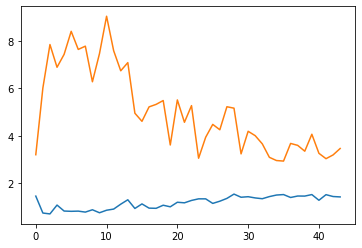

/usr/local/lib/python3.6/dist-packages/torch/storage.py:34: FutureWarning: pickle support for Storage will be removed in 1.5. Use `torch.save` instead
  warnings.warn("pickle support for Storage will be removed in 1.5. Use `torch.save` instead", FutureWarning)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 0, loss_G: 3.4612488746643066, loss_D: 1.416623592376709


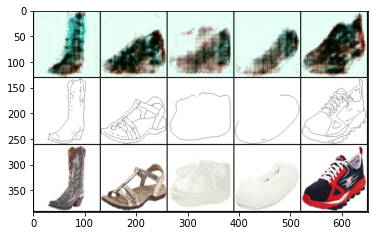

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 50, loss_G: 3.052626132965088, loss_D: 1.4034297466278076


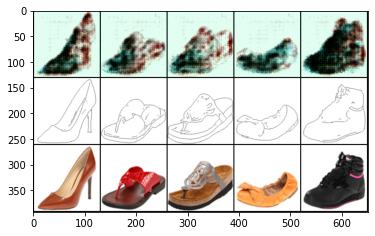

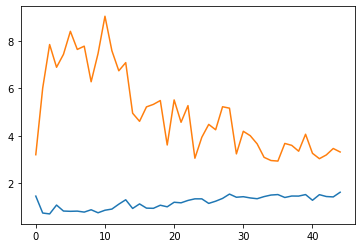

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 100, loss_G: 3.3140153884887695, loss_D: 1.6144256591796875


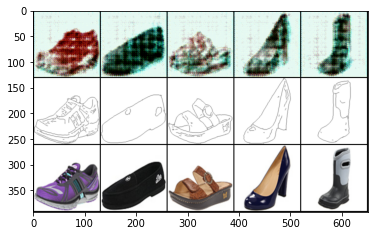

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 150, loss_G: 3.2181825637817383, loss_D: 1.4564305543899536


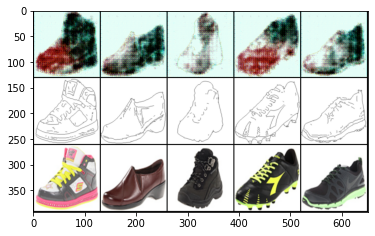

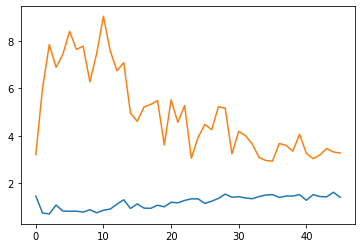

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 200, loss_G: 3.2692766189575195, loss_D: 1.399428129196167


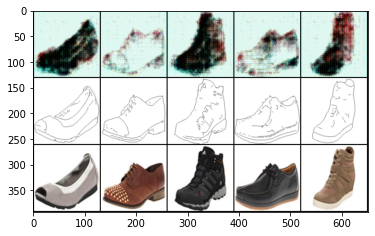

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 250, loss_G: 3.0619068145751953, loss_D: 1.4889330863952637


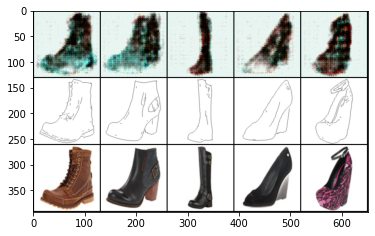

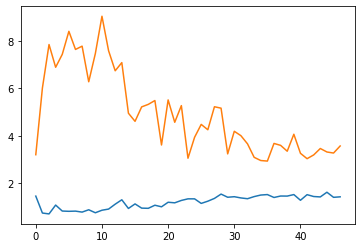

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 300, loss_G: 3.5675048828125, loss_D: 1.4205573797225952


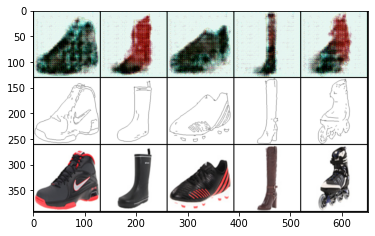

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 350, loss_G: 3.117865800857544, loss_D: 1.5205881595611572


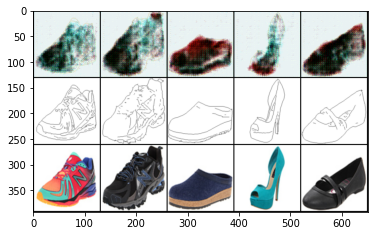

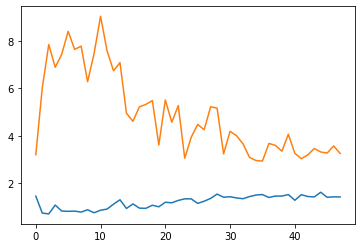

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 400, loss_G: 3.25252628326416, loss_D: 1.415358543395996


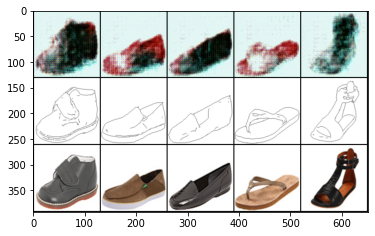

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 450, loss_G: 2.9563517570495605, loss_D: 1.430985450744629


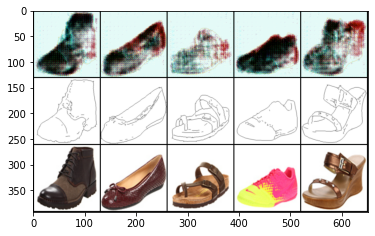

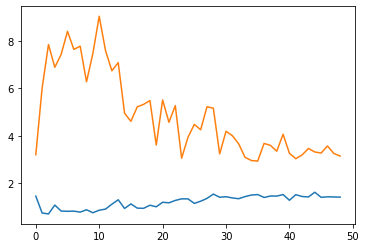

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 500, loss_G: 3.1426596641540527, loss_D: 1.4067320823669434


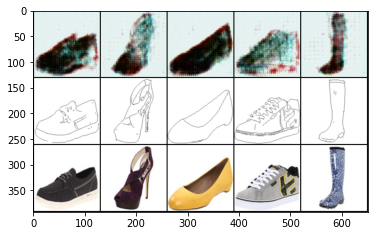

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 550, loss_G: 3.3727216720581055, loss_D: 1.216848611831665


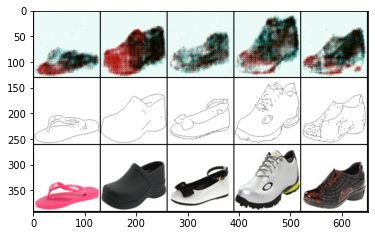

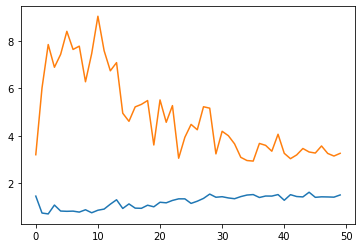

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 600, loss_G: 3.257420539855957, loss_D: 1.4997209310531616


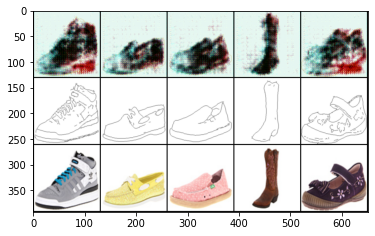

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 650, loss_G: 3.044130325317383, loss_D: 1.390781044960022


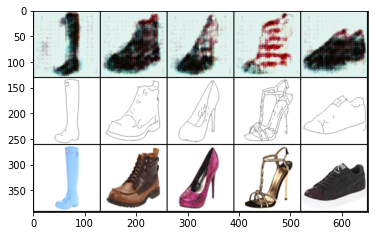

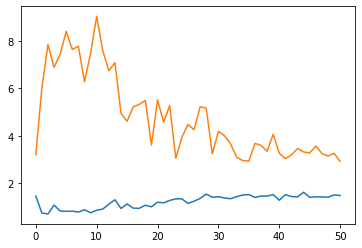

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 700, loss_G: 2.914030075073242, loss_D: 1.4768946170806885


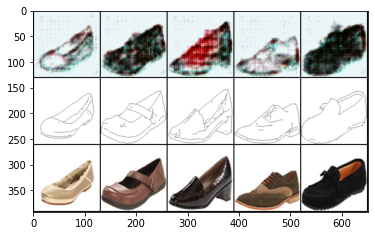

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 750, loss_G: 2.9142141342163086, loss_D: 1.4311211109161377


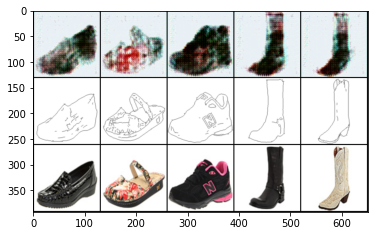

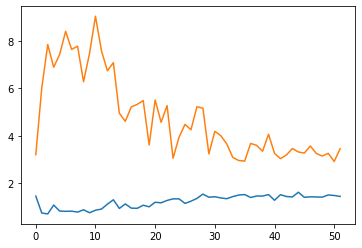

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 800, loss_G: 3.4528772830963135, loss_D: 1.4386640787124634


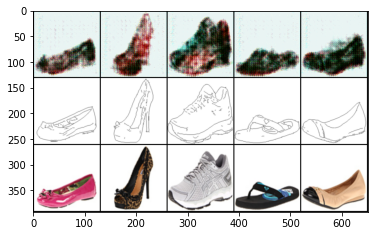

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 850, loss_G: 3.245847225189209, loss_D: 1.40791916847229


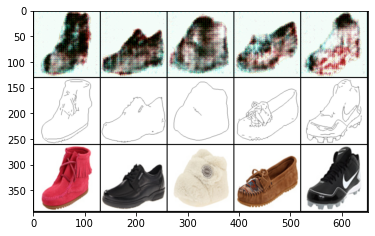

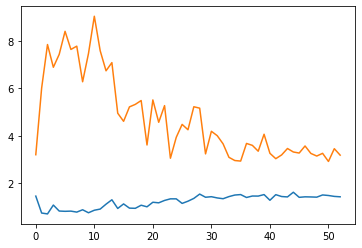

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 900, loss_G: 3.180508852005005, loss_D: 1.4217240810394287


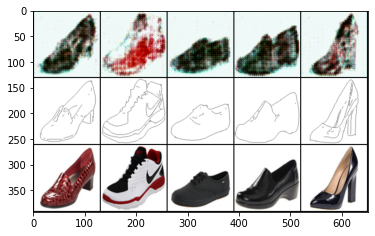

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 950, loss_G: 3.244204044342041, loss_D: 1.408141851425171


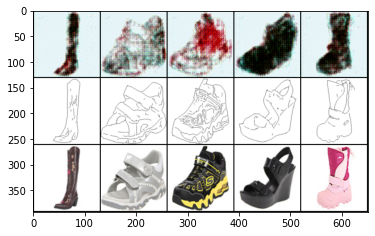

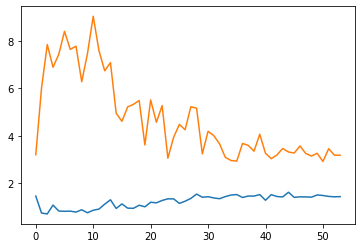

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1000, loss_G: 3.1751155853271484, loss_D: 1.4297224283218384


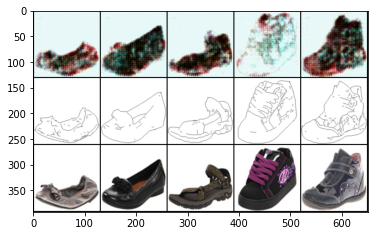

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1050, loss_G: 3.065653085708618, loss_D: 1.4536430835723877


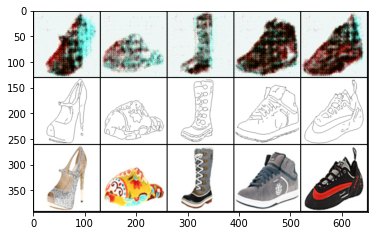

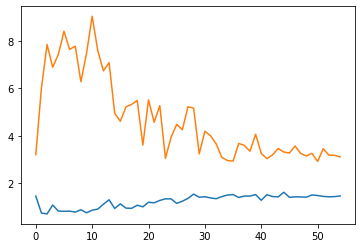

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1100, loss_G: 3.1050992012023926, loss_D: 1.45786714553833


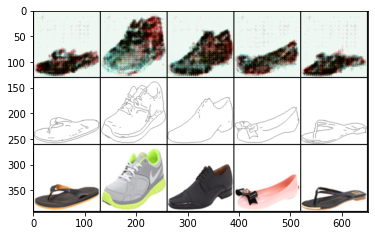

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1150, loss_G: 3.1751275062561035, loss_D: 1.4242939949035645


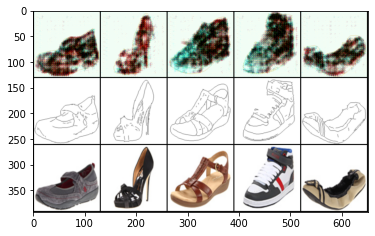

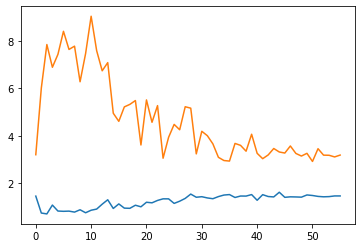

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1200, loss_G: 3.1838250160217285, loss_D: 1.4579427242279053


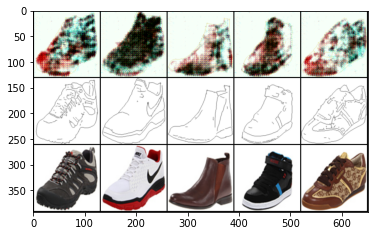

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1250, loss_G: 3.043255567550659, loss_D: 1.4074931144714355


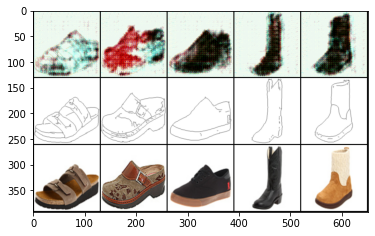

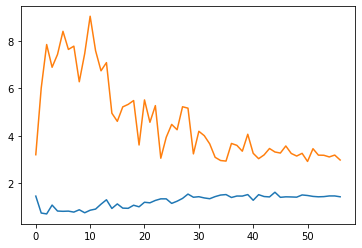

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1300, loss_G: 2.97527813911438, loss_D: 1.4222332239151


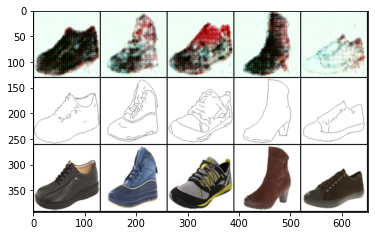

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1350, loss_G: 3.302489757537842, loss_D: 1.3830280303955078


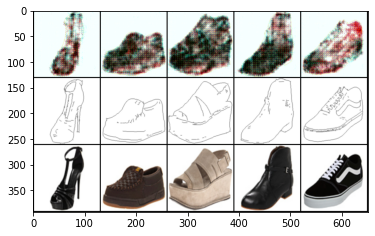

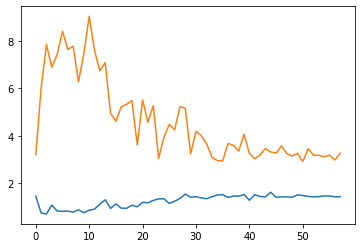

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1400, loss_G: 3.2604660987854004, loss_D: 1.420939326286316


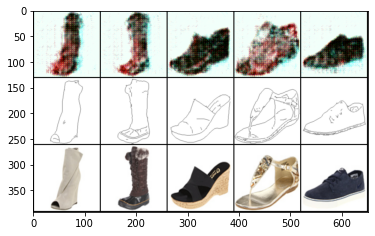

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1450, loss_G: 3.196938991546631, loss_D: 1.3450366258621216


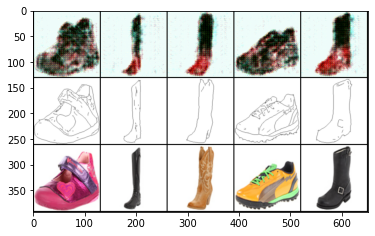

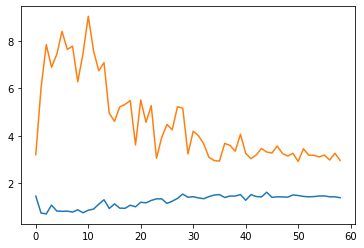

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1500, loss_G: 2.9576339721679688, loss_D: 1.3846793174743652


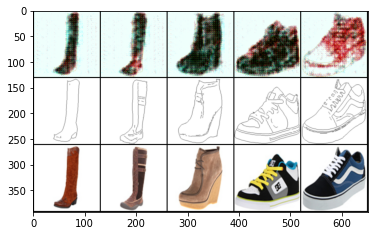

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 0, iter: 1550, loss_G: 3.1047236919403076, loss_D: 1.4357738494873047


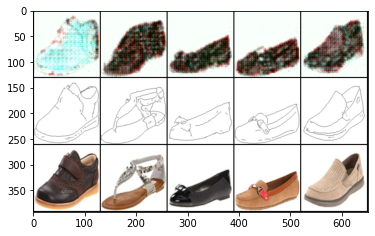

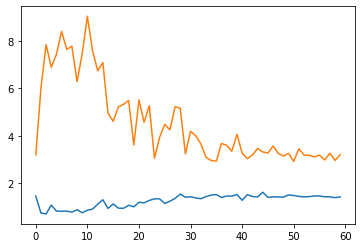

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 0, loss_G: 3.201779365539551, loss_D: 1.4169453382492065


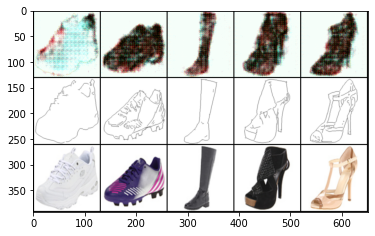

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 50, loss_G: 3.1310648918151855, loss_D: 1.4253230094909668


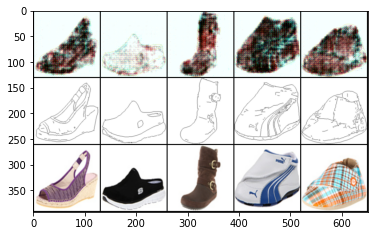

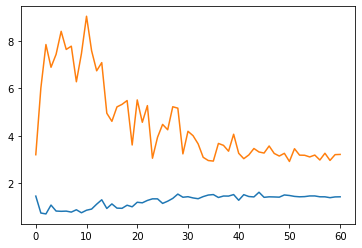

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 100, loss_G: 3.210991621017456, loss_D: 1.4213707447052002


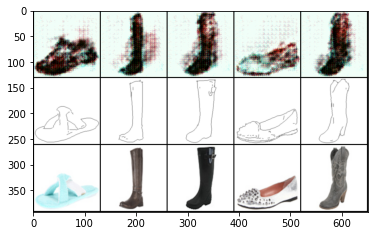

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 150, loss_G: 3.019852876663208, loss_D: 1.4272735118865967


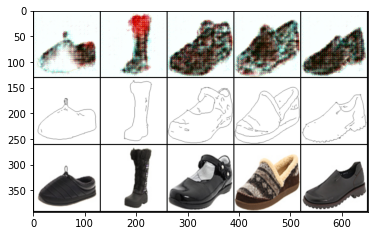

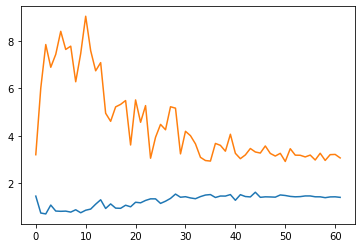

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 200, loss_G: 3.063244342803955, loss_D: 1.3980603218078613


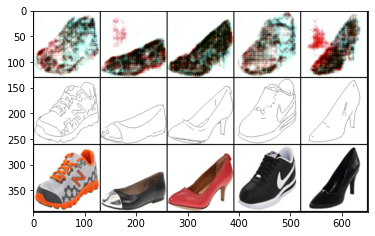

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 250, loss_G: 3.0534822940826416, loss_D: 1.426948070526123


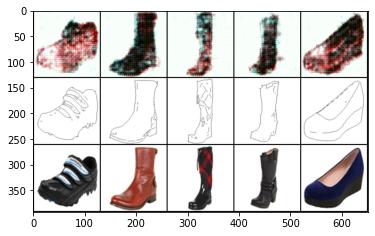

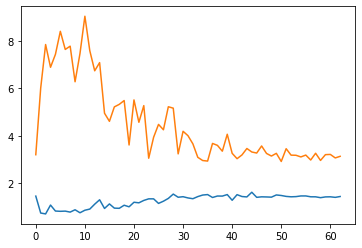

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 300, loss_G: 3.131108045578003, loss_D: 1.4341809749603271


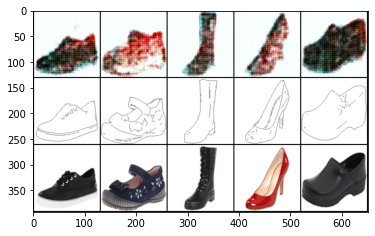

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 350, loss_G: 3.2528815269470215, loss_D: 1.3942179679870605


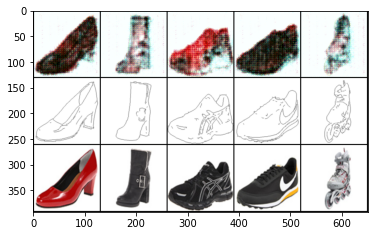

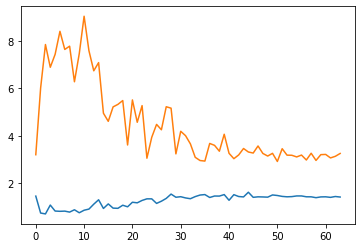

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 400, loss_G: 3.2518415451049805, loss_D: 1.411692500114441


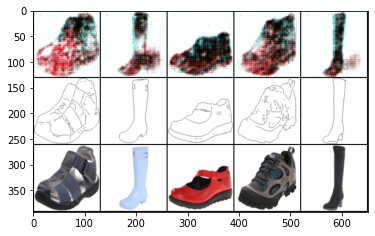

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 450, loss_G: 3.1568236351013184, loss_D: 1.4365720748901367


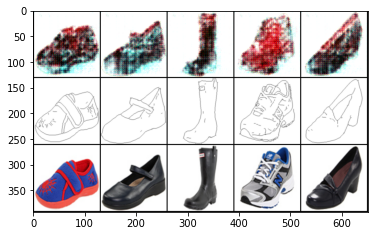

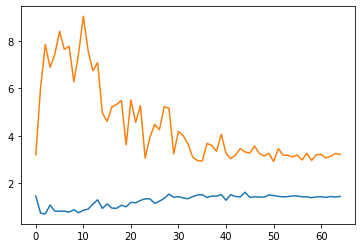

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 500, loss_G: 3.2096996307373047, loss_D: 1.4377843141555786


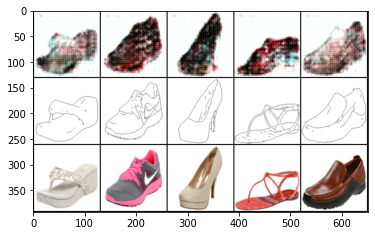

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 550, loss_G: 3.1726484298706055, loss_D: 1.3556543588638306


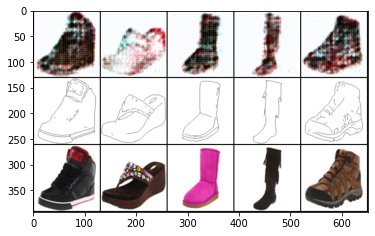

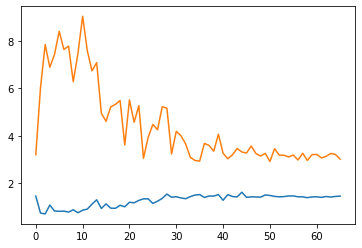

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 600, loss_G: 3.011505603790283, loss_D: 1.4507414102554321


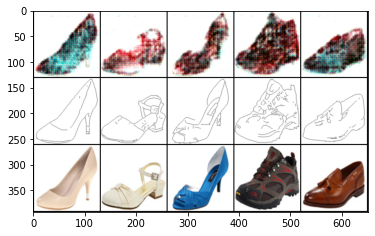

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 650, loss_G: 3.1341958045959473, loss_D: 1.418344497680664


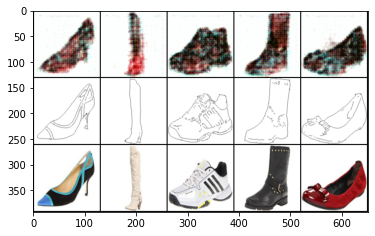

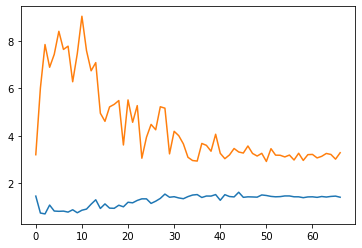

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 700, loss_G: 3.282414197921753, loss_D: 1.4034092426300049


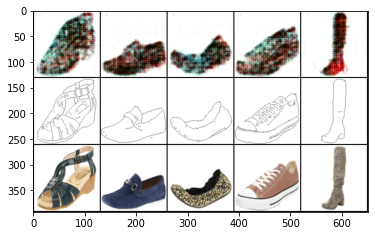

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 750, loss_G: 3.1529760360717773, loss_D: 1.4324339628219604


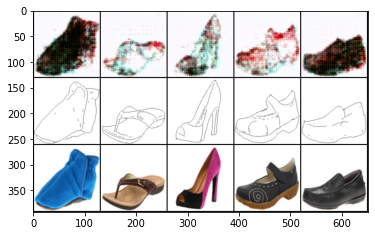

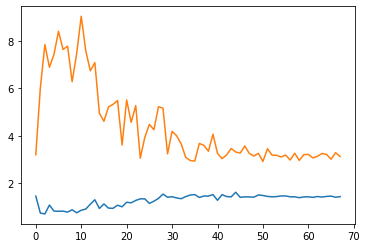

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 800, loss_G: 3.1223373413085938, loss_D: 1.428514003753662


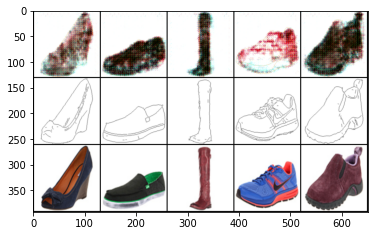

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 850, loss_G: 3.16143536567688, loss_D: 1.400709629058838


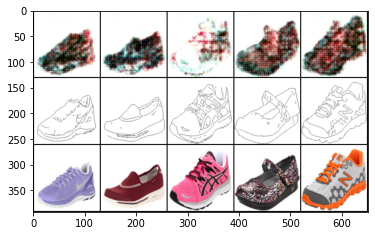

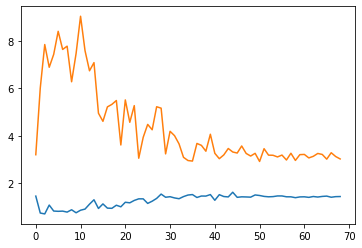

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 900, loss_G: 3.0200934410095215, loss_D: 1.4326847791671753


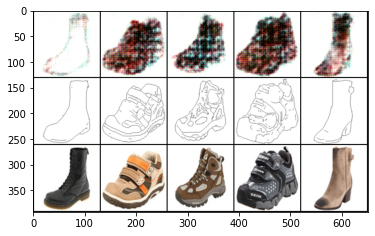

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 950, loss_G: 3.154085397720337, loss_D: 1.403236746788025


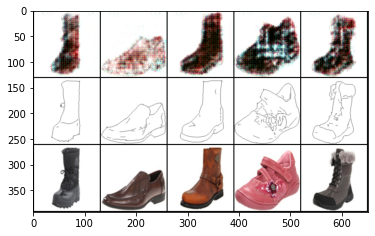

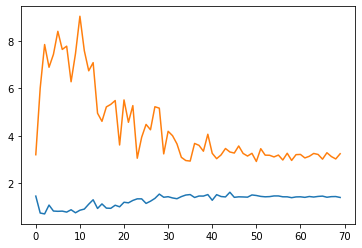

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1000, loss_G: 3.239499807357788, loss_D: 1.393932819366455


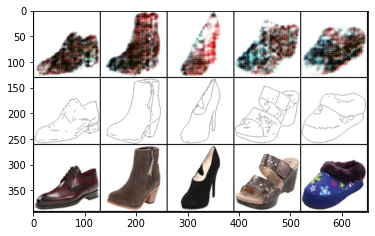

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1050, loss_G: 3.174962043762207, loss_D: 1.424199104309082


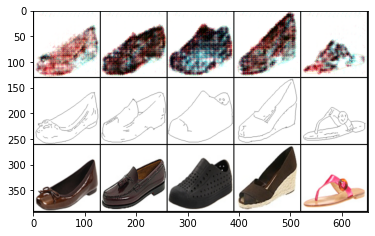

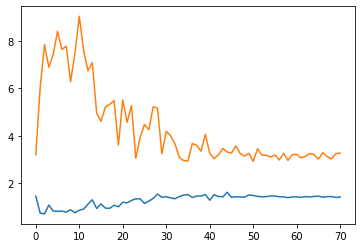

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1100, loss_G: 3.2706046104431152, loss_D: 1.4131603240966797


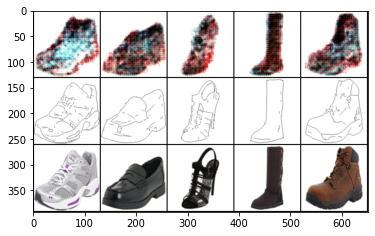

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1150, loss_G: 3.1615540981292725, loss_D: 1.39641273021698


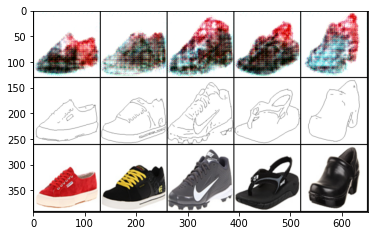

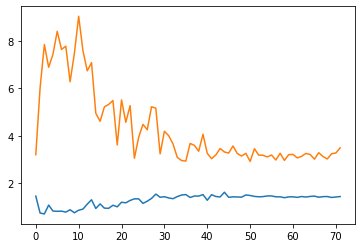

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1200, loss_G: 3.489262580871582, loss_D: 1.4328746795654297


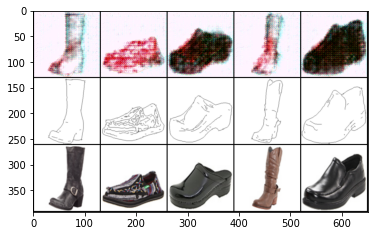

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1250, loss_G: 3.2538366317749023, loss_D: 1.4167405366897583


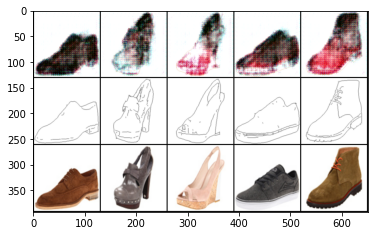

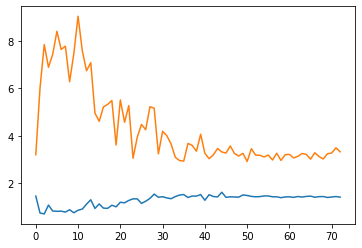

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1300, loss_G: 3.3211379051208496, loss_D: 1.4067223072052002


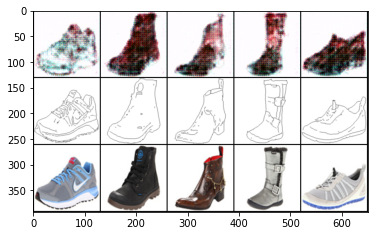

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1350, loss_G: 3.1956520080566406, loss_D: 1.4079104661941528


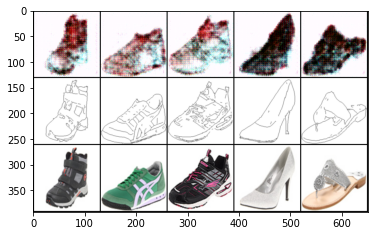

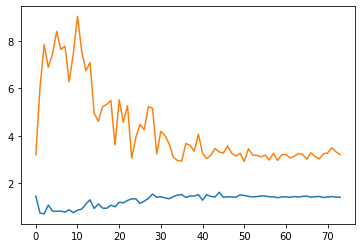

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1400, loss_G: 3.2048778533935547, loss_D: 1.4055919647216797


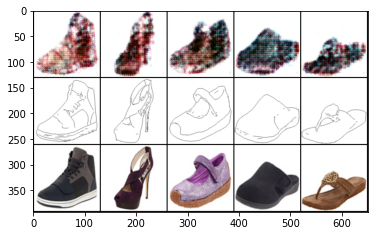

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1450, loss_G: 3.148041009902954, loss_D: 1.417680263519287


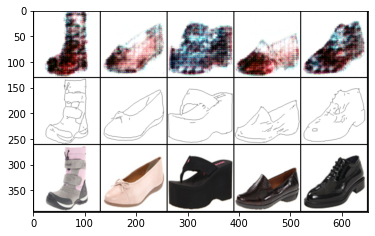

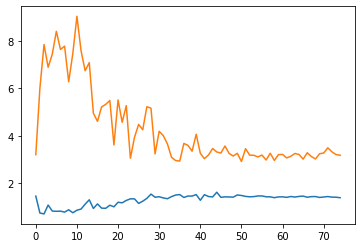

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1500, loss_G: 3.175664186477661, loss_D: 1.3831995725631714


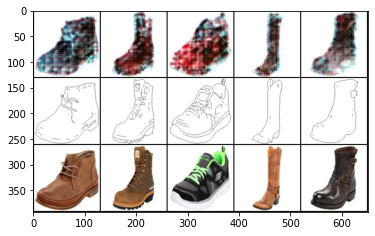

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 1, iter: 1550, loss_G: 3.14420747756958, loss_D: 1.3870371580123901


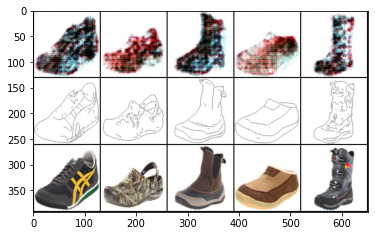

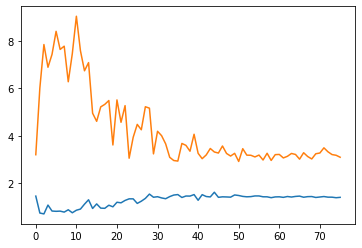

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 0, loss_G: 3.0920519828796387, loss_D: 1.398879051208496


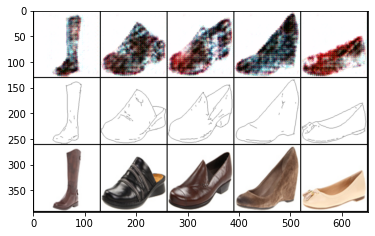

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 50, loss_G: 3.2875566482543945, loss_D: 1.411895990371704


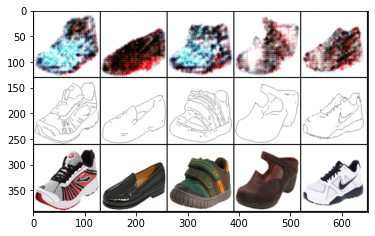

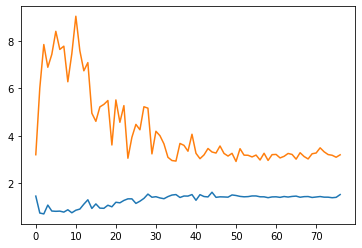

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 100, loss_G: 3.1948299407958984, loss_D: 1.5160516500473022


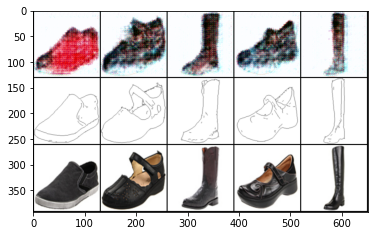

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 150, loss_G: 3.185789108276367, loss_D: 1.4218159914016724


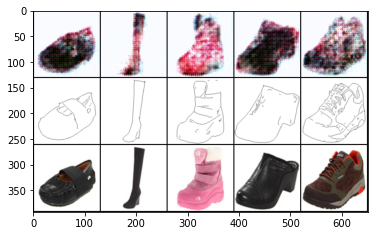

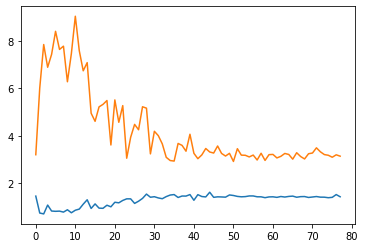

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 200, loss_G: 3.13698673248291, loss_D: 1.4227454662322998


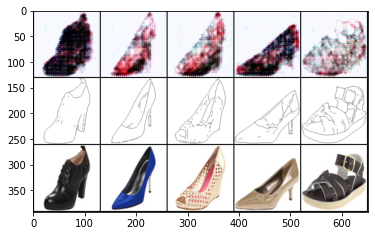

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 250, loss_G: 3.0516765117645264, loss_D: 1.4234325885772705


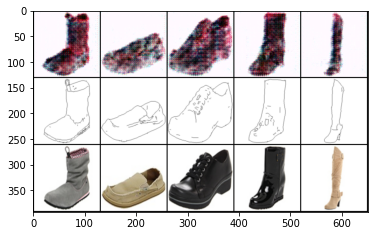

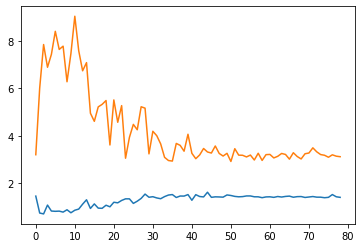

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 300, loss_G: 3.11476993560791, loss_D: 1.3984636068344116


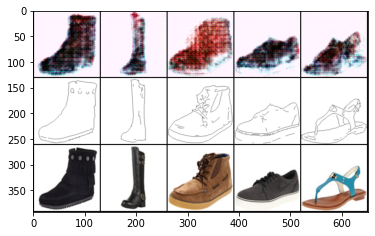

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 350, loss_G: 3.187490940093994, loss_D: 1.4140324592590332


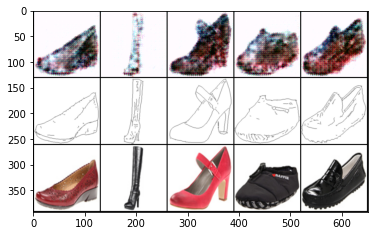

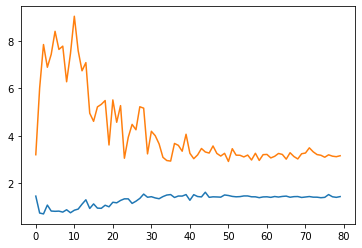

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 400, loss_G: 3.1553499698638916, loss_D: 1.4306448698043823


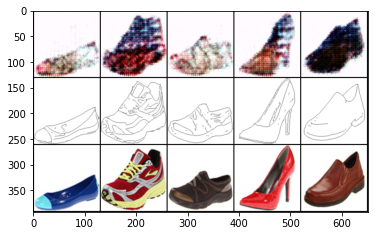

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 450, loss_G: 3.3151326179504395, loss_D: 1.3795521259307861


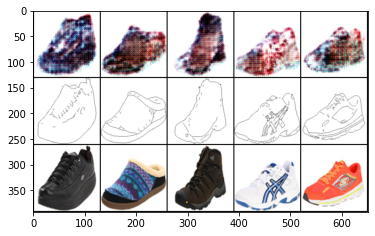

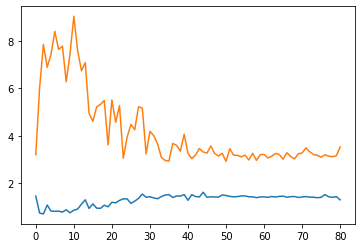

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 500, loss_G: 3.5251104831695557, loss_D: 1.2938776016235352


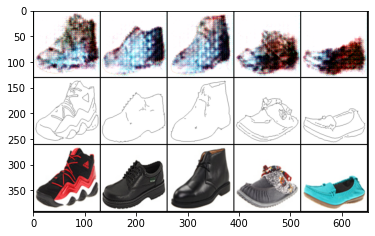

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 550, loss_G: 3.4531874656677246, loss_D: 1.4882651567459106


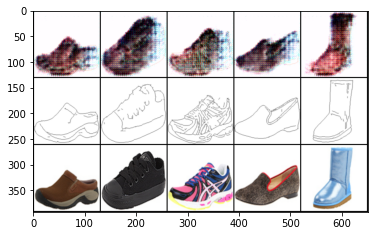

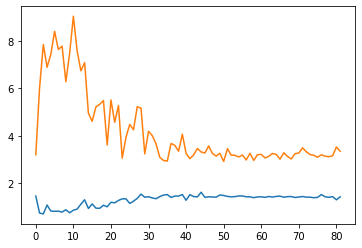

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 600, loss_G: 3.343146324157715, loss_D: 1.419539451599121


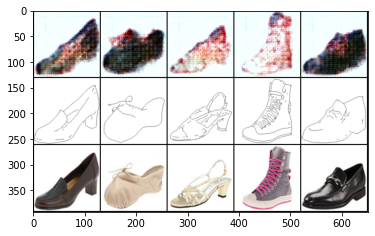

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 650, loss_G: 3.0624289512634277, loss_D: 1.5373377799987793


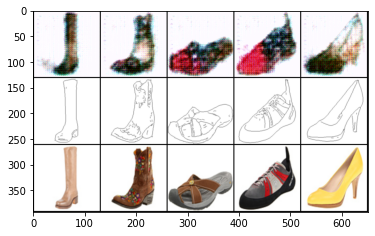

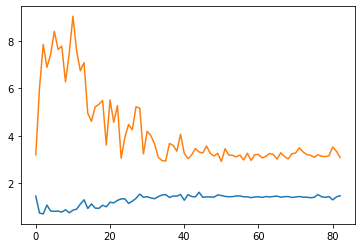

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 700, loss_G: 3.0780434608459473, loss_D: 1.466426968574524


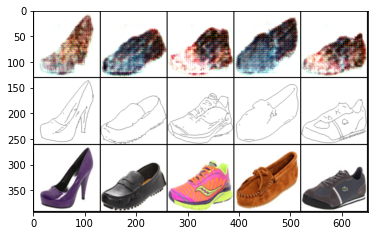

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 750, loss_G: 3.1318159103393555, loss_D: 1.4402823448181152


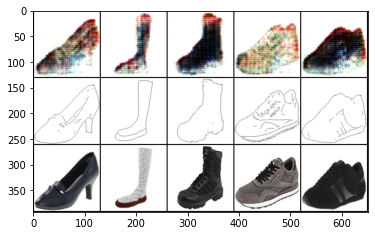

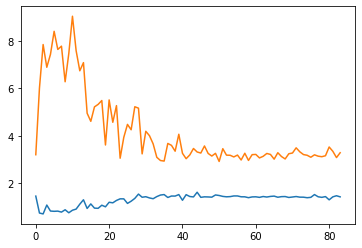

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 800, loss_G: 3.2822022438049316, loss_D: 1.419539213180542


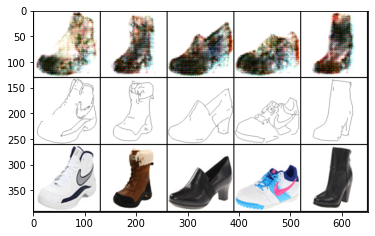

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 850, loss_G: 3.2799949645996094, loss_D: 1.409662127494812


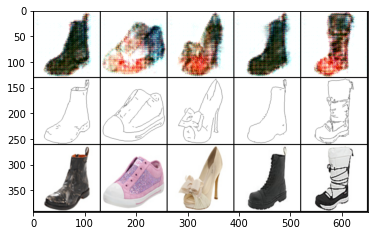

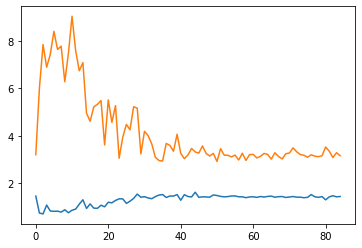

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 900, loss_G: 3.1571426391601562, loss_D: 1.4350359439849854


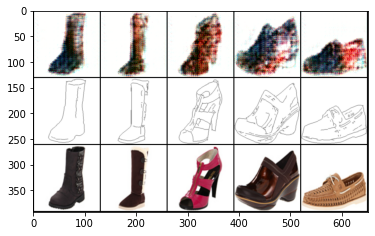

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 950, loss_G: 3.134232997894287, loss_D: 1.3929765224456787


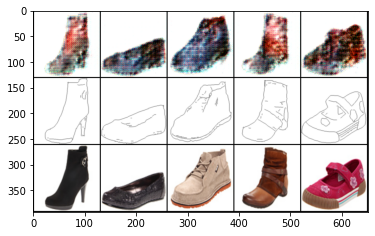

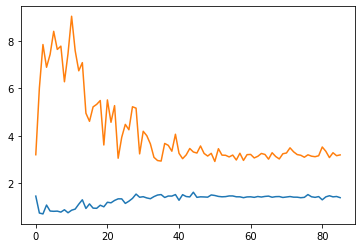

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1000, loss_G: 3.191051959991455, loss_D: 1.3852533102035522


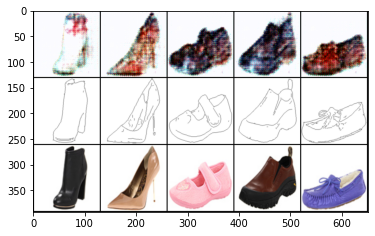

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1050, loss_G: 3.071887731552124, loss_D: 1.4090232849121094


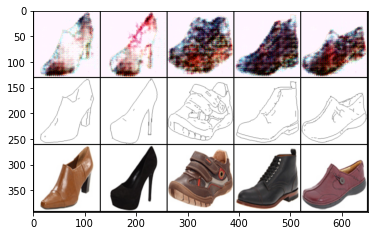

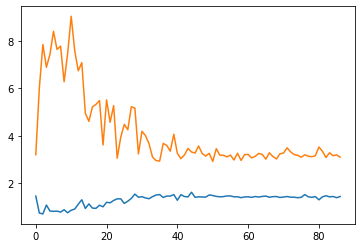

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1100, loss_G: 3.0953023433685303, loss_D: 1.4328652620315552


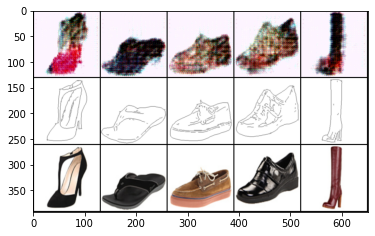

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1150, loss_G: 3.0393638610839844, loss_D: 1.445695161819458


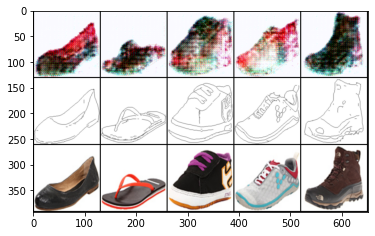

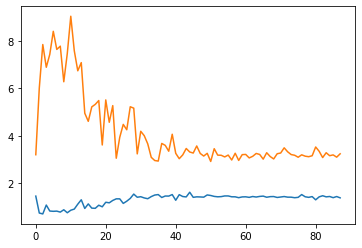

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1200, loss_G: 3.236915111541748, loss_D: 1.377393126487732


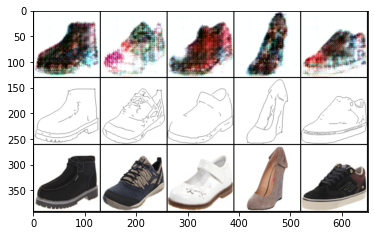

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1250, loss_G: 3.1353206634521484, loss_D: 1.4110065698623657


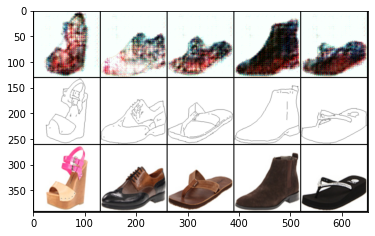

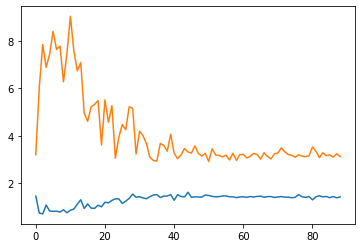

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1300, loss_G: 3.124812126159668, loss_D: 1.4185471534729004


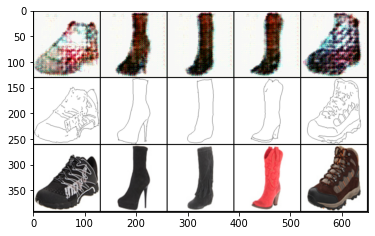

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1350, loss_G: 3.1120102405548096, loss_D: 1.4276319742202759


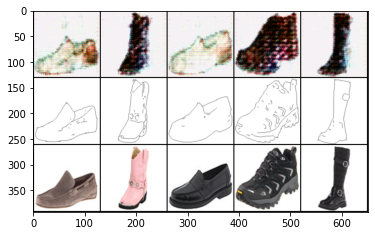

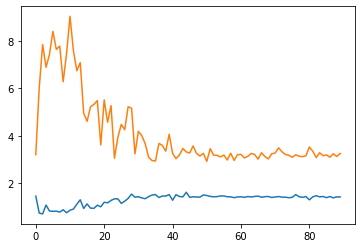

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1400, loss_G: 3.253220558166504, loss_D: 1.4145679473876953


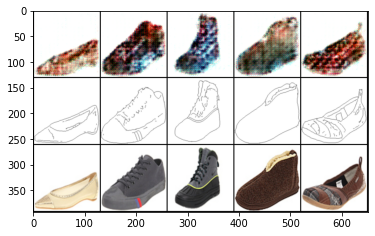

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1450, loss_G: 3.1666526794433594, loss_D: 1.4045580625534058


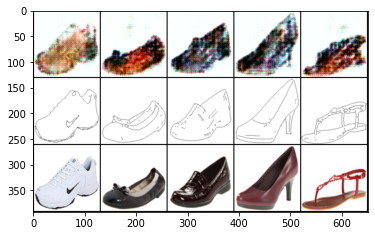

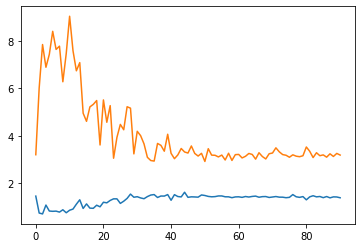

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1500, loss_G: 3.183701276779175, loss_D: 1.3808910846710205


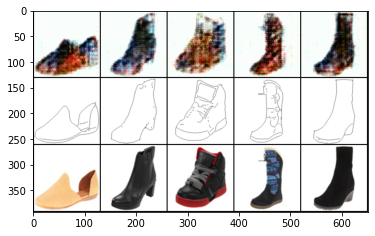

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 2, iter: 1550, loss_G: 3.1801066398620605, loss_D: 1.4003289937973022


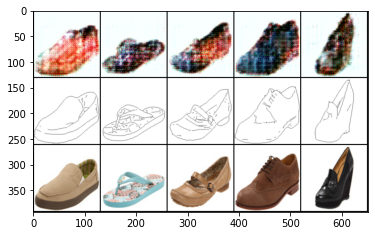

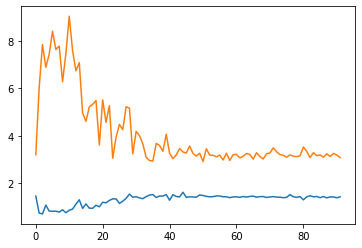

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 0, loss_G: 3.072969675064087, loss_D: 1.421748161315918


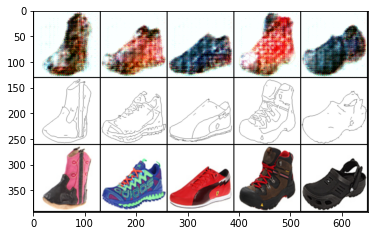

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 50, loss_G: 3.1349830627441406, loss_D: 1.4186116456985474


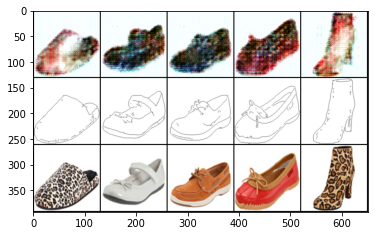

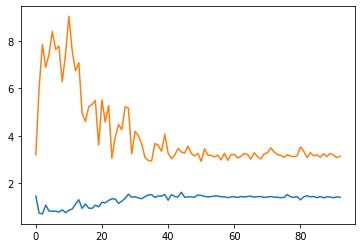

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 100, loss_G: 3.1401619911193848, loss_D: 1.3999662399291992


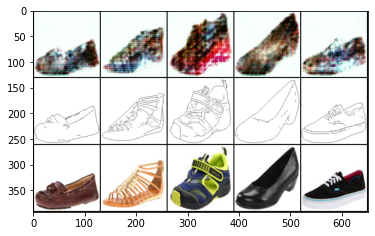

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 150, loss_G: 3.1973142623901367, loss_D: 1.4074628353118896


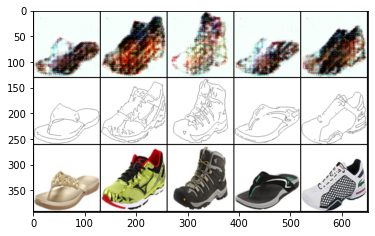

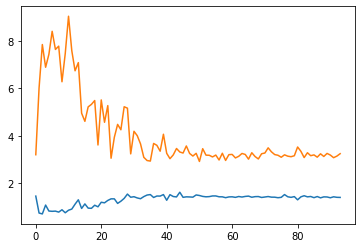

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 200, loss_G: 3.2421875, loss_D: 1.3956921100616455


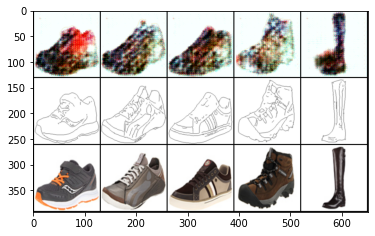

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 250, loss_G: 3.221559524536133, loss_D: 1.4105799198150635


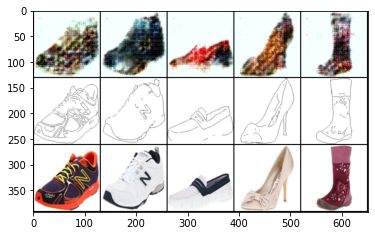

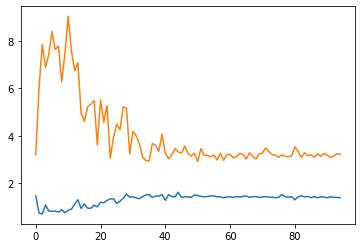

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 300, loss_G: 3.217417001724243, loss_D: 1.3842287063598633


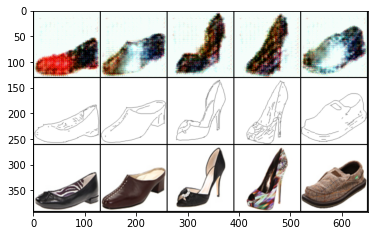

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 350, loss_G: 3.159323215484619, loss_D: 1.4132635593414307


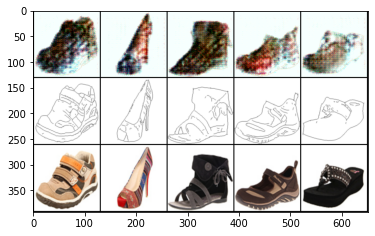

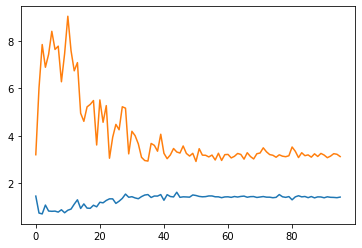

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 400, loss_G: 3.1205973625183105, loss_D: 1.409809947013855


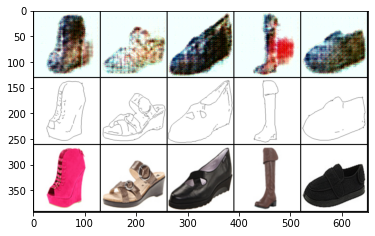

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 450, loss_G: 3.276667594909668, loss_D: 1.4157023429870605


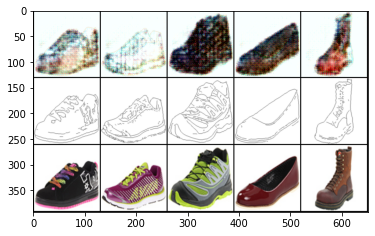

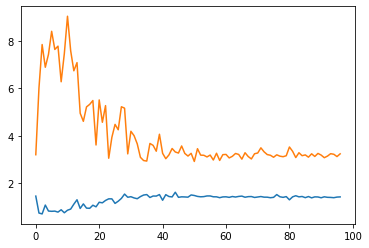

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 500, loss_G: 3.235414981842041, loss_D: 1.417281150817871


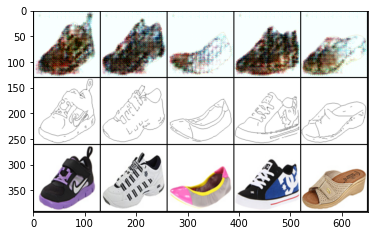

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 550, loss_G: 3.1840927600860596, loss_D: 1.392165184020996


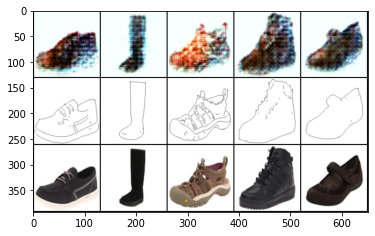

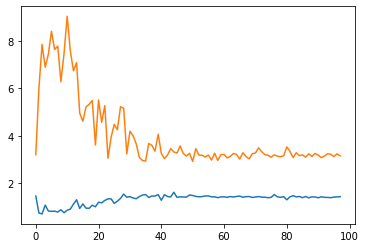

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 600, loss_G: 3.1492395401000977, loss_D: 1.4276244640350342


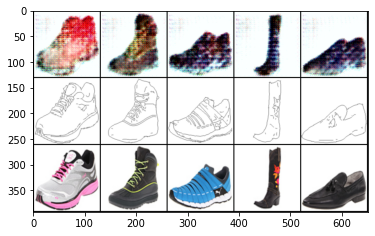

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 650, loss_G: 3.2007296085357666, loss_D: 1.409986972808838


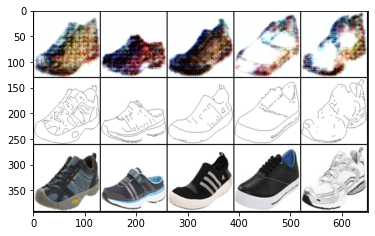

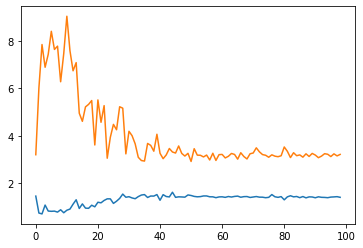

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 700, loss_G: 3.211527109146118, loss_D: 1.4002487659454346


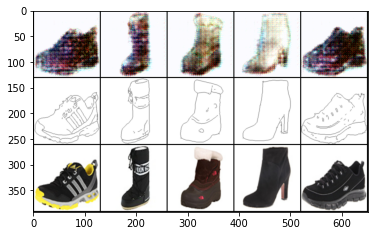

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 750, loss_G: 3.1582837104797363, loss_D: 1.423223853111267


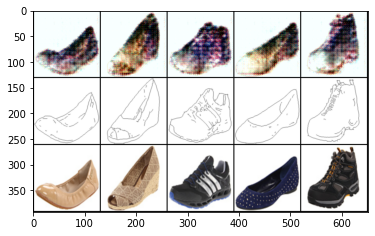

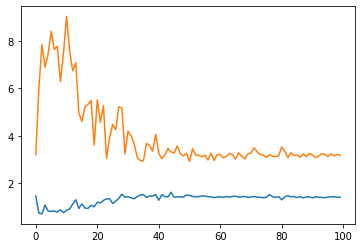

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 800, loss_G: 3.168320655822754, loss_D: 1.4046636819839478


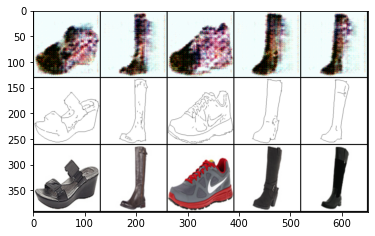

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 850, loss_G: 3.178722381591797, loss_D: 1.3984805345535278


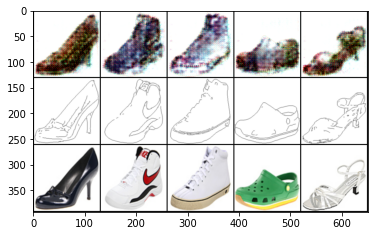

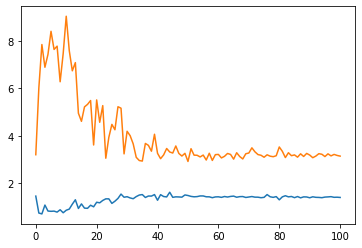

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 900, loss_G: 3.139580249786377, loss_D: 1.39430570602417


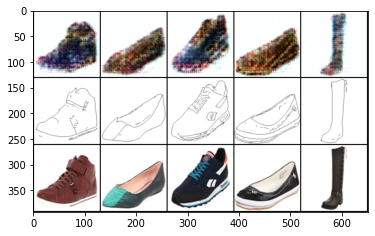

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 950, loss_G: 3.1476802825927734, loss_D: 1.426457405090332


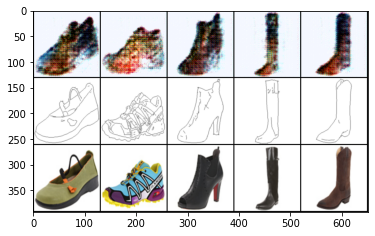

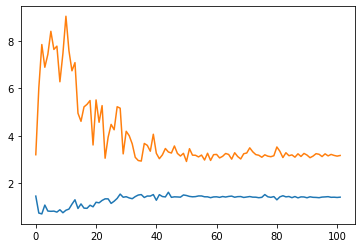

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1000, loss_G: 3.1665709018707275, loss_D: 1.4063159227371216


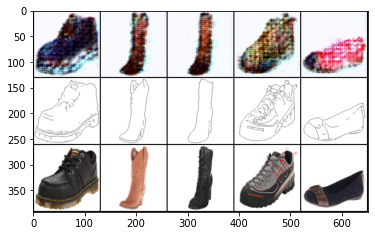

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1050, loss_G: 3.2558090686798096, loss_D: 1.4042456150054932


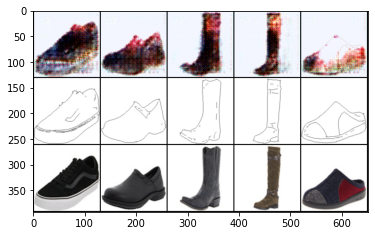

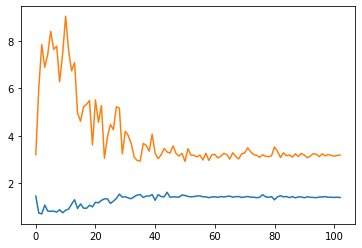

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1100, loss_G: 3.1872079372406006, loss_D: 1.3923083543777466


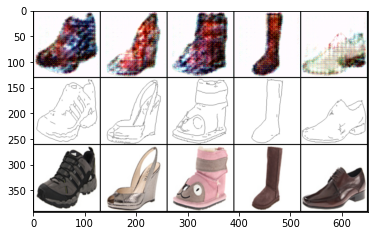

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1150, loss_G: 3.0923967361450195, loss_D: 1.422651767730713


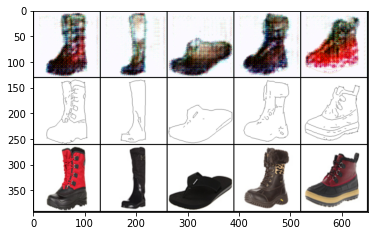

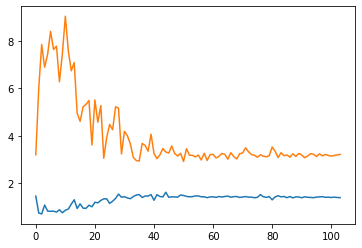

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1200, loss_G: 3.21268892288208, loss_D: 1.3873518705368042


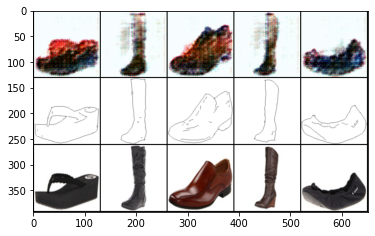

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1250, loss_G: 3.246394634246826, loss_D: 1.3972792625427246


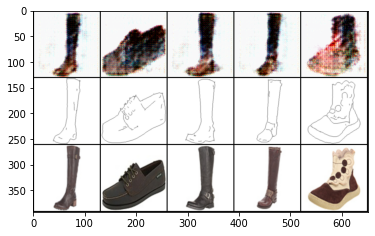

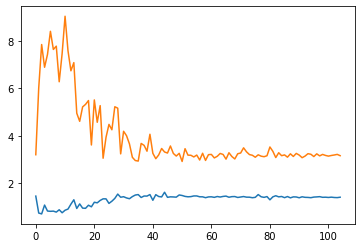

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1300, loss_G: 3.158060312271118, loss_D: 1.4043028354644775


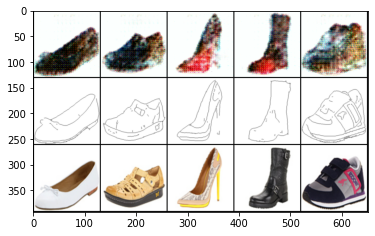

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1350, loss_G: 3.1920113563537598, loss_D: 1.4185128211975098


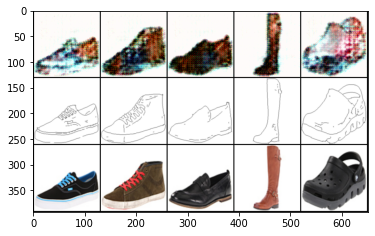

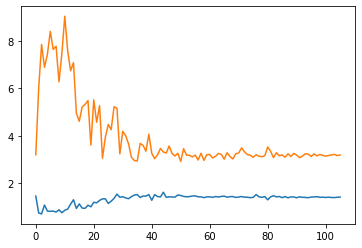

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1400, loss_G: 3.188585042953491, loss_D: 1.409518837928772


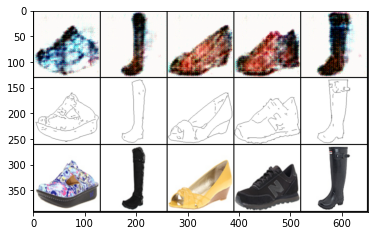

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1450, loss_G: 3.093672037124634, loss_D: 1.4104039669036865


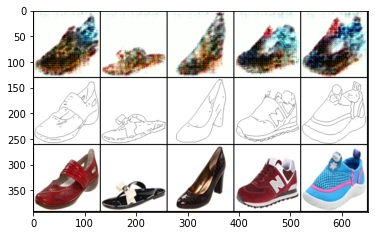

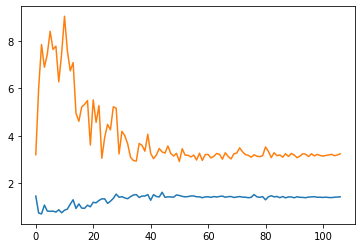

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1500, loss_G: 3.2348742485046387, loss_D: 1.4207905530929565


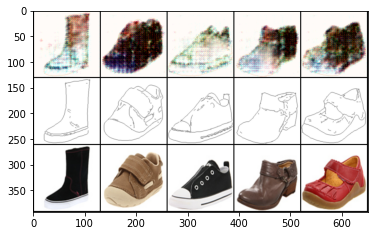

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 3, iter: 1550, loss_G: 3.129274845123291, loss_D: 1.427543044090271


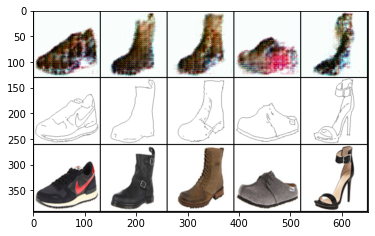

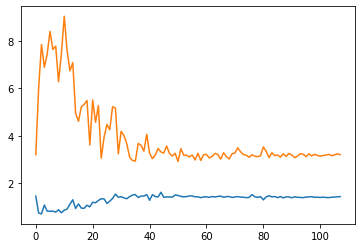

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 0, loss_G: 3.2027621269226074, loss_D: 1.4307931661605835


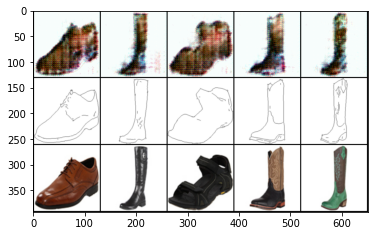

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 50, loss_G: 3.1058521270751953, loss_D: 1.4082216024398804


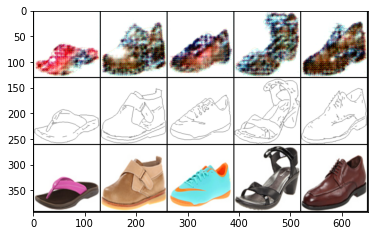

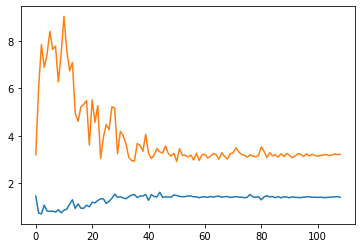

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 100, loss_G: 3.215108871459961, loss_D: 1.403733491897583


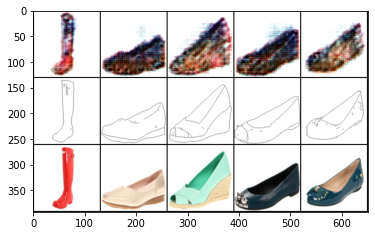

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 150, loss_G: 3.2207894325256348, loss_D: 1.3956984281539917


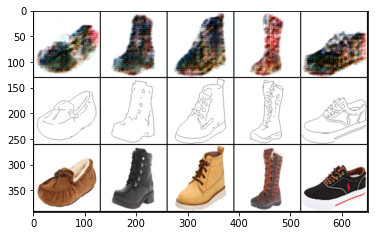

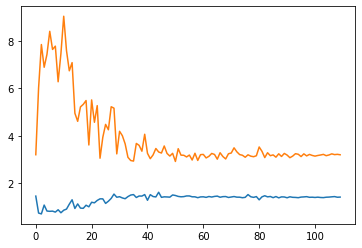

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 200, loss_G: 3.196593761444092, loss_D: 1.4096181392669678


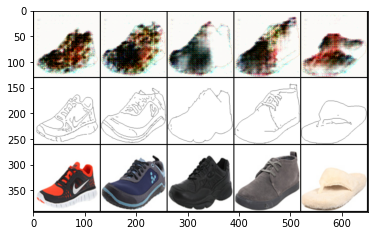

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 250, loss_G: 3.1106367111206055, loss_D: 1.408217191696167


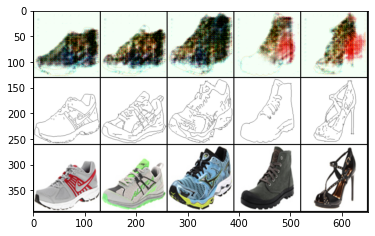

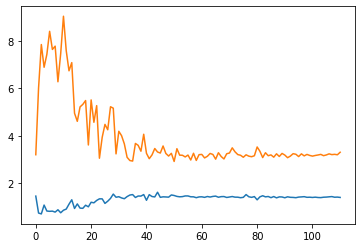

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 300, loss_G: 3.302924394607544, loss_D: 1.395106554031372


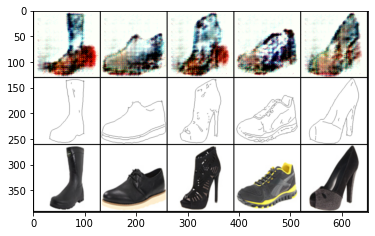

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 350, loss_G: 3.186610698699951, loss_D: 1.4524437189102173


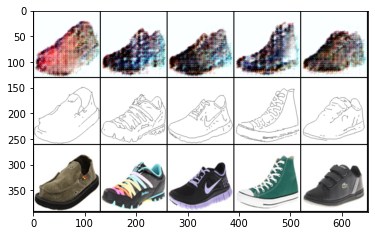

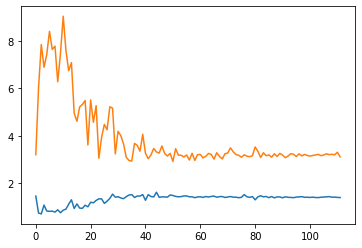

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 400, loss_G: 3.1069111824035645, loss_D: 1.390932321548462


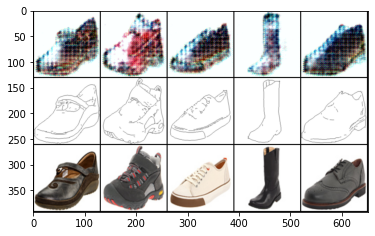

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 450, loss_G: 3.1763834953308105, loss_D: 1.4274877309799194


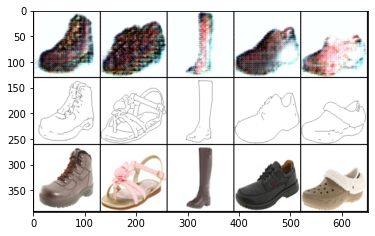

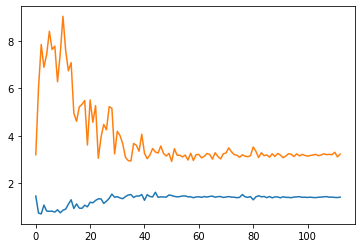

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 500, loss_G: 3.2235660552978516, loss_D: 1.4065239429473877


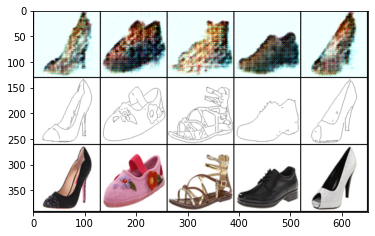

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 550, loss_G: 3.2644095420837402, loss_D: 1.4118108749389648


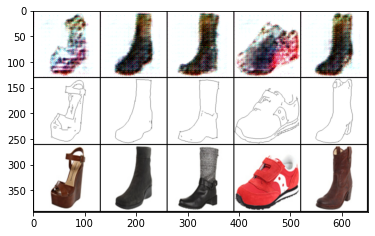

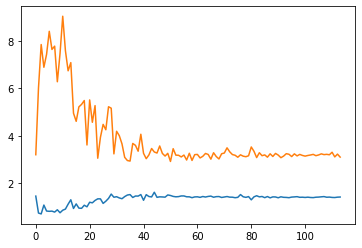

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 600, loss_G: 3.0977582931518555, loss_D: 1.4120160341262817


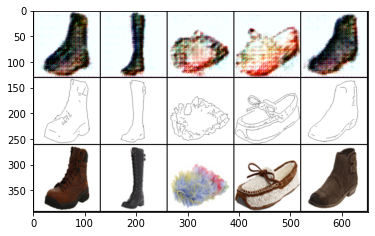

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 650, loss_G: 3.170480251312256, loss_D: 1.3912893533706665


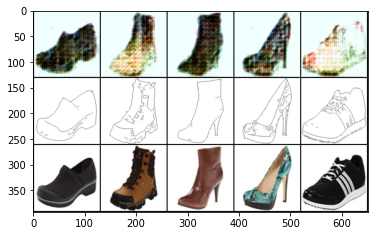

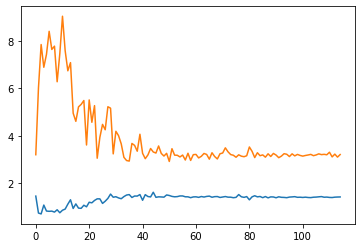

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 700, loss_G: 3.2050256729125977, loss_D: 1.4153640270233154


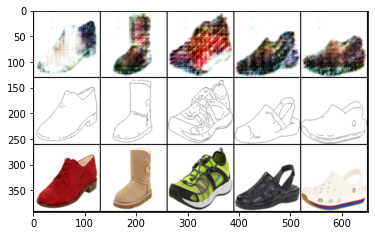

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 750, loss_G: 3.127440929412842, loss_D: 1.404332160949707


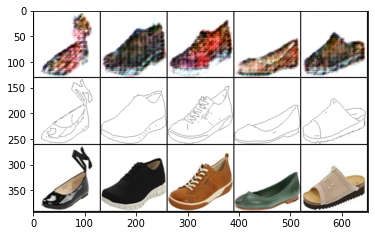

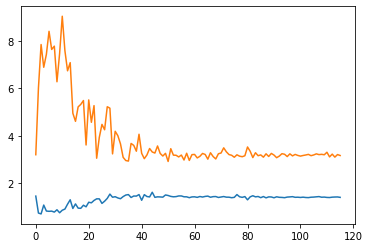

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 800, loss_G: 3.165038585662842, loss_D: 1.398037314414978


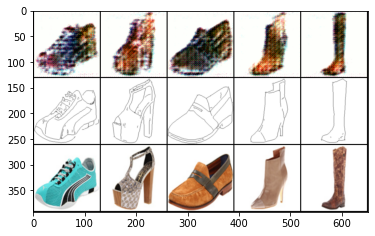

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 850, loss_G: 3.136660575866699, loss_D: 1.4033913612365723


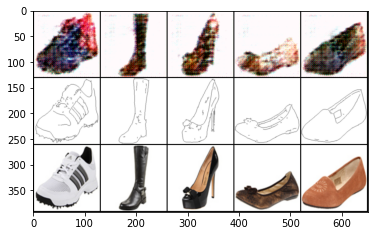

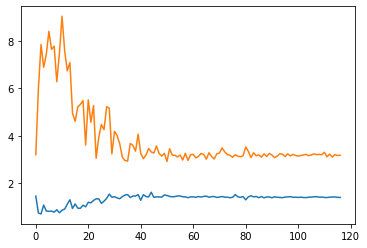

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 900, loss_G: 3.1742825508117676, loss_D: 1.3953847885131836


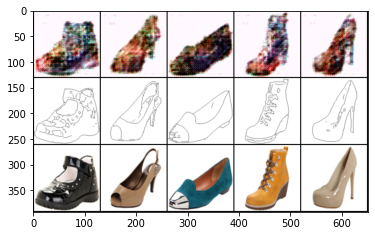

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 950, loss_G: 3.147928237915039, loss_D: 1.40810227394104


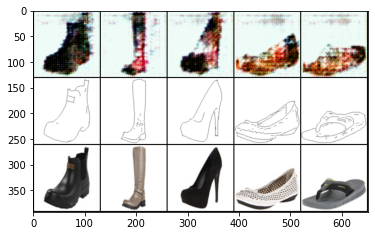

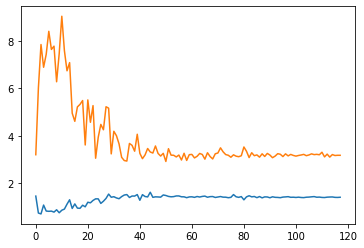

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1000, loss_G: 3.1742231845855713, loss_D: 1.4026100635528564


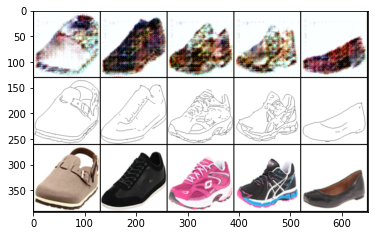

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1050, loss_G: 3.1926305294036865, loss_D: 1.389836311340332


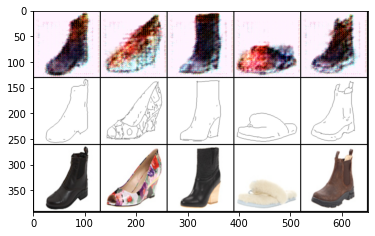

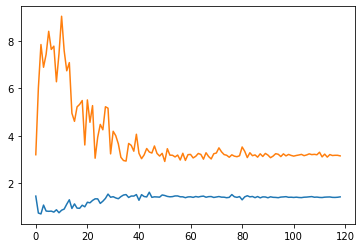

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1100, loss_G: 3.149543285369873, loss_D: 1.4185810089111328


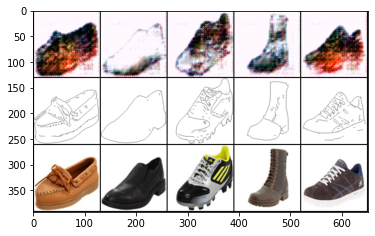

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1150, loss_G: 3.1625592708587646, loss_D: 1.4039024114608765


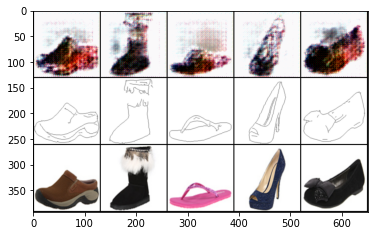

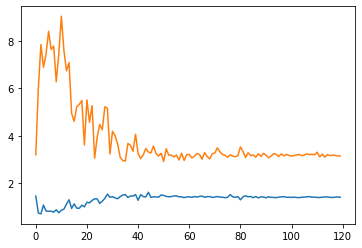

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1200, loss_G: 3.1465744972229004, loss_D: 1.401950478553772


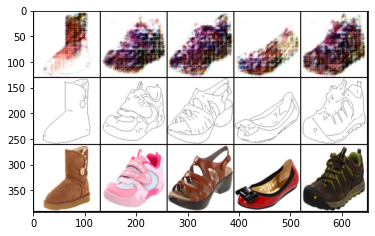

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1250, loss_G: 3.1503794193267822, loss_D: 1.3988456726074219


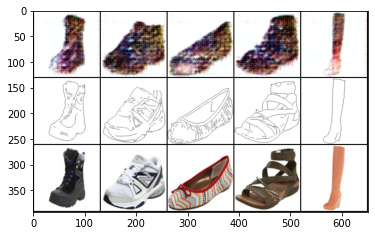

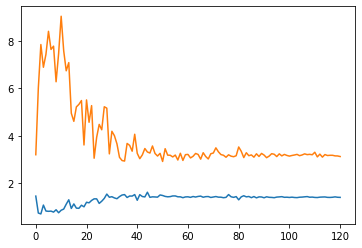

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1300, loss_G: 3.122265100479126, loss_D: 1.3971788883209229


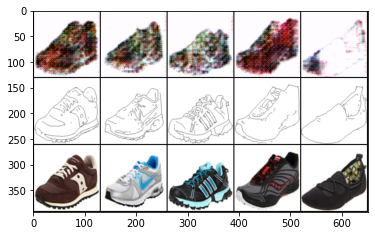

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1350, loss_G: 3.172961950302124, loss_D: 1.3981003761291504


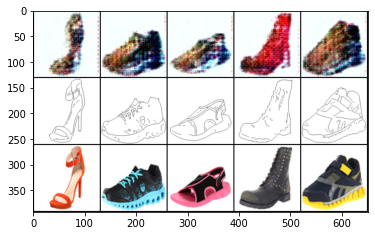

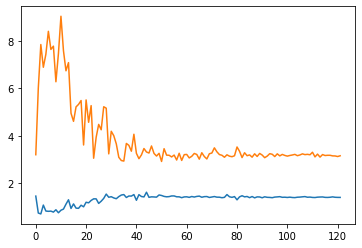

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1400, loss_G: 3.154186487197876, loss_D: 1.3961939811706543


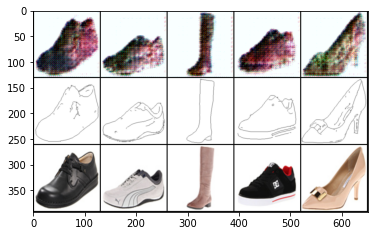

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1450, loss_G: 3.145753860473633, loss_D: 1.392747402191162


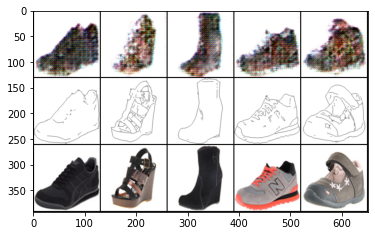

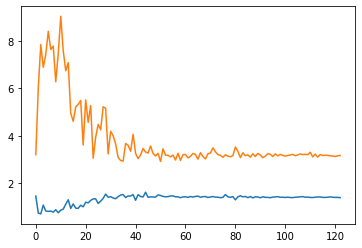

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1500, loss_G: 3.1659059524536133, loss_D: 1.3875267505645752


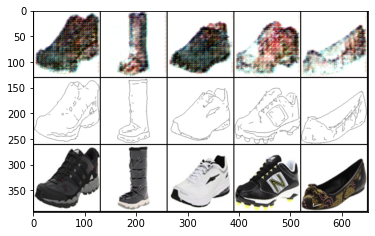

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 4, iter: 1550, loss_G: 3.1896753311157227, loss_D: 1.3986425399780273


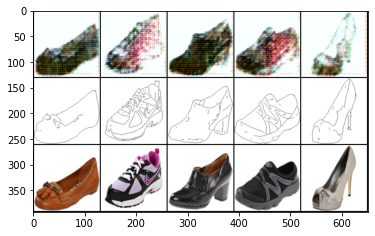

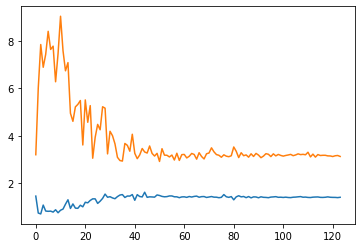

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 0, loss_G: 3.1253559589385986, loss_D: 1.4012598991394043


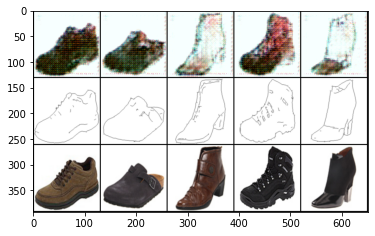

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 50, loss_G: 3.3087878227233887, loss_D: 1.3643052577972412


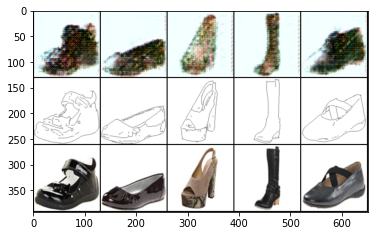

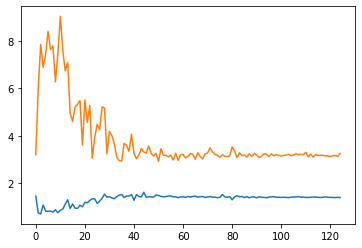

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 100, loss_G: 3.253157138824463, loss_D: 1.390486478805542


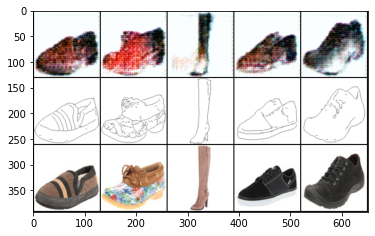

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 150, loss_G: 3.1915717124938965, loss_D: 1.428898811340332


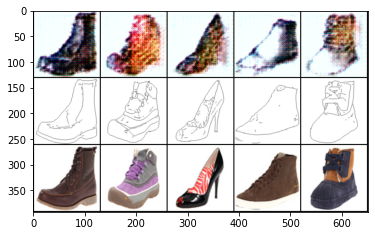

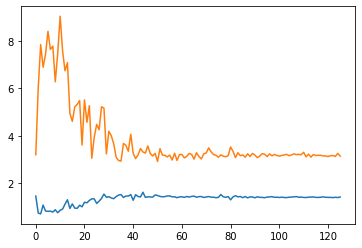

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 200, loss_G: 3.1388440132141113, loss_D: 1.4134752750396729


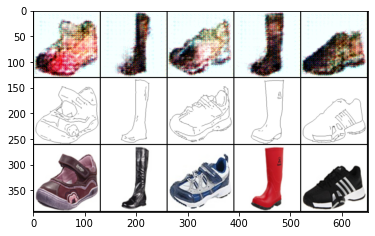

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 250, loss_G: 3.1387343406677246, loss_D: 1.411253809928894


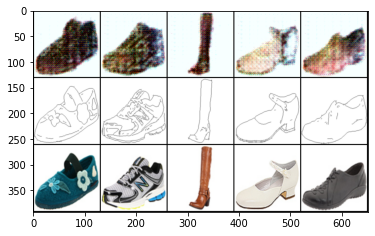

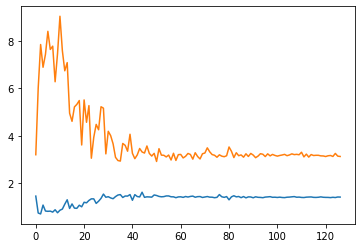

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 300, loss_G: 3.124598979949951, loss_D: 1.4096004962921143


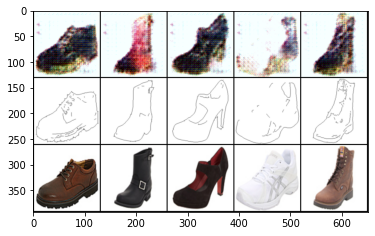

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 350, loss_G: 3.1720261573791504, loss_D: 1.3906700611114502


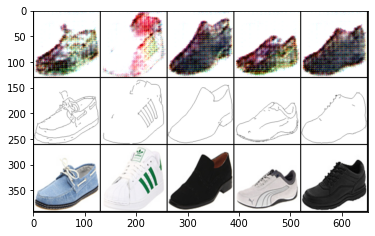

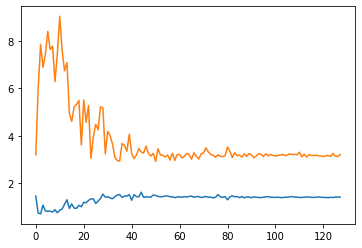

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 400, loss_G: 3.205005407333374, loss_D: 1.4078354835510254


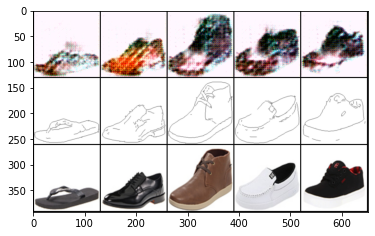

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 450, loss_G: 3.0696020126342773, loss_D: 1.4164180755615234


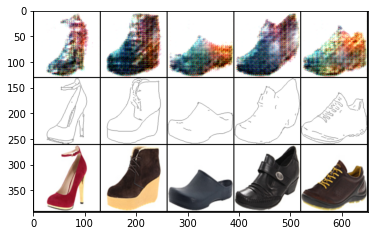

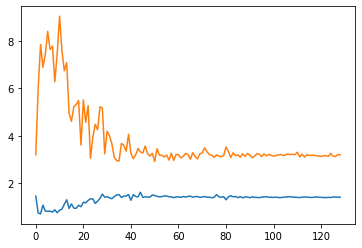

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 500, loss_G: 3.1933603286743164, loss_D: 1.4045612812042236


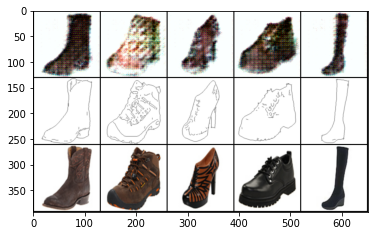

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 550, loss_G: 3.180708408355713, loss_D: 1.4014968872070312


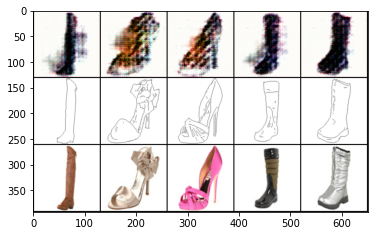

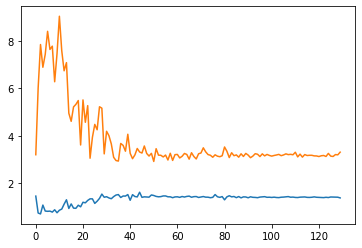

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 600, loss_G: 3.306413173675537, loss_D: 1.3750625848770142


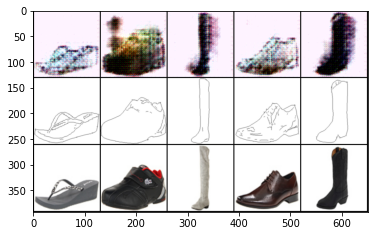

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 650, loss_G: 3.2246665954589844, loss_D: 1.4065830707550049


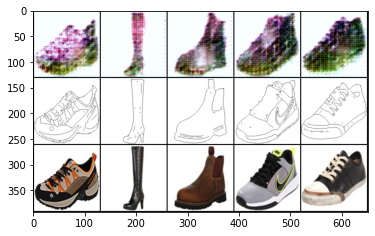

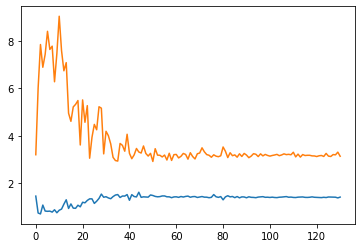

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 700, loss_G: 3.134132146835327, loss_D: 1.4095128774642944


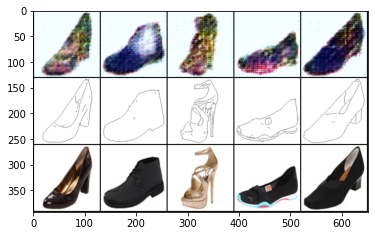

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 750, loss_G: 3.1850194931030273, loss_D: 1.3982396125793457


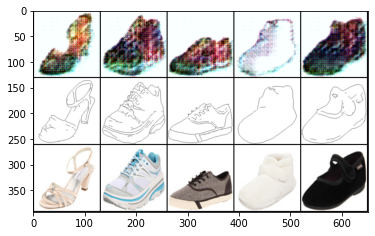

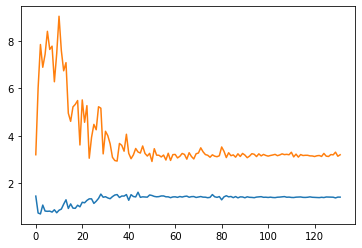

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 800, loss_G: 3.1964704990386963, loss_D: 1.4075630903244019


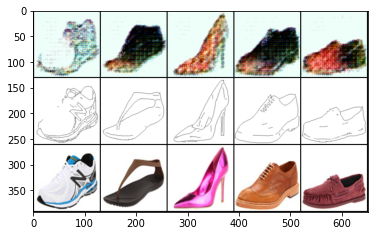

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 850, loss_G: 3.140875816345215, loss_D: 1.4041434526443481


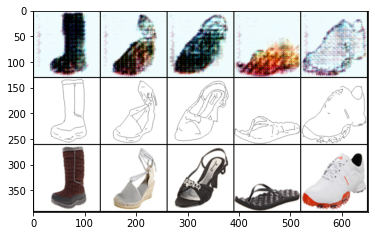

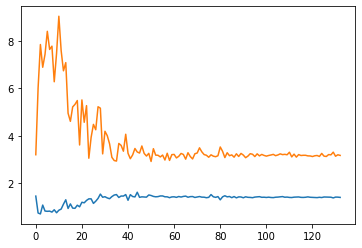

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 900, loss_G: 3.1696133613586426, loss_D: 1.3964323997497559


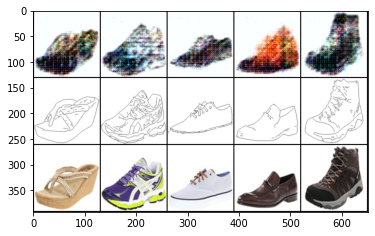

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 950, loss_G: 3.18938946723938, loss_D: 1.4033797979354858


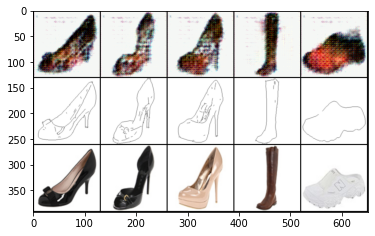

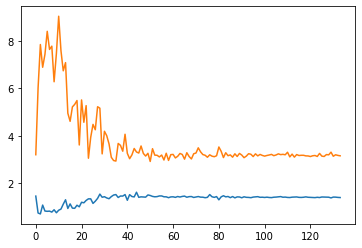

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1000, loss_G: 3.152759313583374, loss_D: 1.3902201652526855


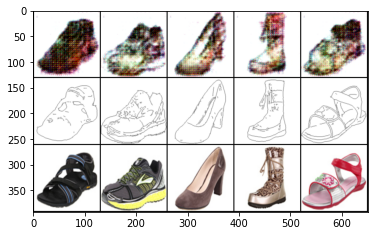

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1050, loss_G: 3.2189862728118896, loss_D: 1.3919926881790161


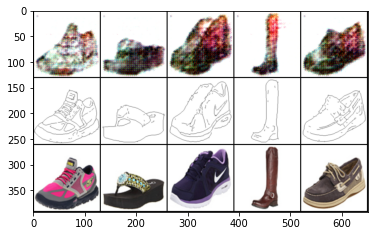

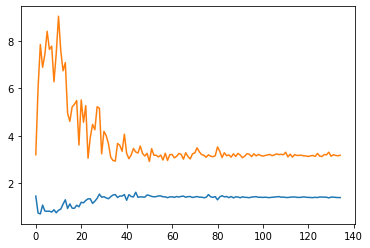

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1100, loss_G: 3.176664352416992, loss_D: 1.3896092176437378


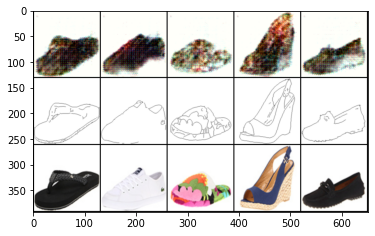

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1150, loss_G: 3.1503026485443115, loss_D: 1.3983042240142822


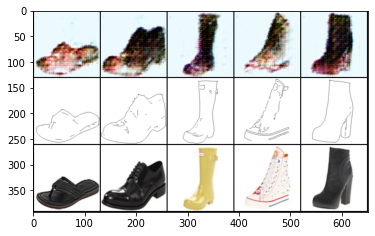

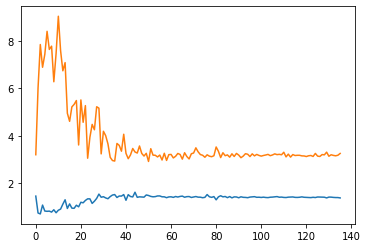

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1200, loss_G: 3.252363681793213, loss_D: 1.3741704225540161


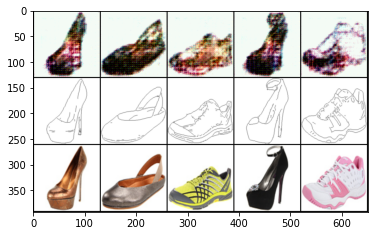

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1250, loss_G: 3.1913299560546875, loss_D: 1.3971753120422363


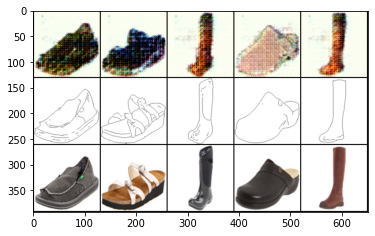

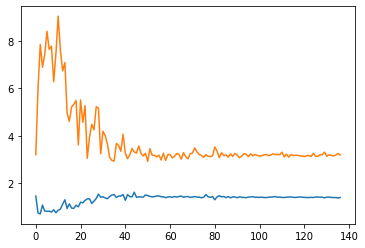

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1300, loss_G: 3.1868550777435303, loss_D: 1.391697883605957


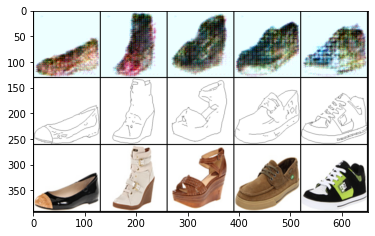

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1350, loss_G: 3.1352150440216064, loss_D: 1.3882343769073486


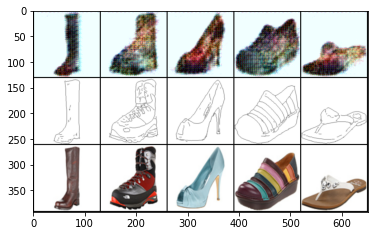

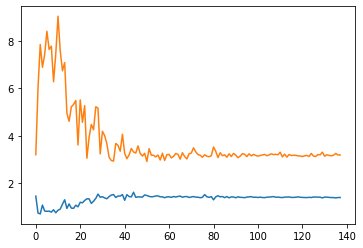

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1400, loss_G: 3.188753128051758, loss_D: 1.3919031620025635


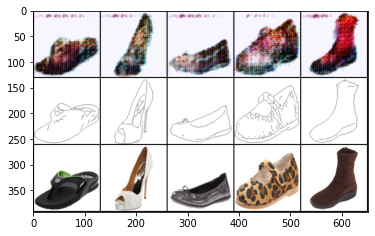

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1450, loss_G: 3.1834659576416016, loss_D: 1.3914687633514404


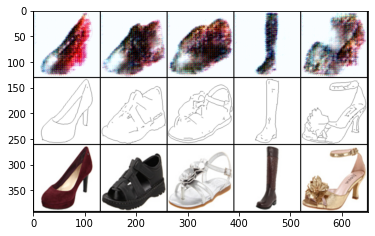

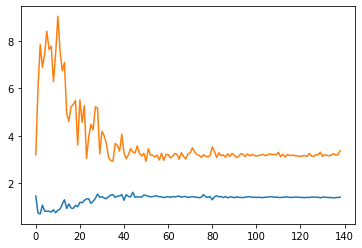

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1500, loss_G: 3.368929862976074, loss_D: 1.4097352027893066


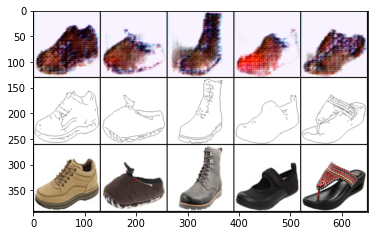

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 5, iter: 1550, loss_G: 3.2968311309814453, loss_D: 1.4293549060821533


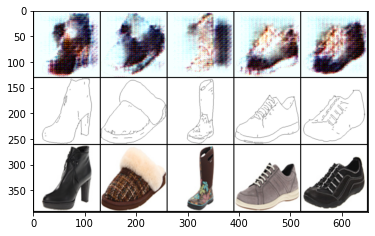

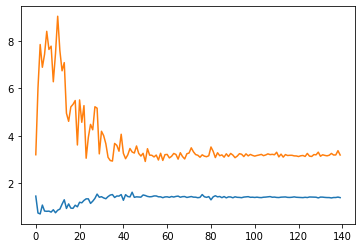

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 0, loss_G: 3.185823440551758, loss_D: 1.387082576751709


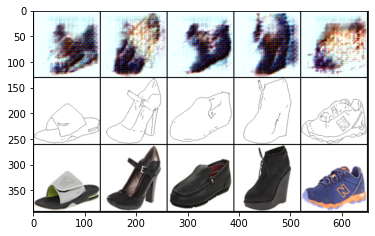

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 50, loss_G: 3.2242085933685303, loss_D: 1.4354363679885864


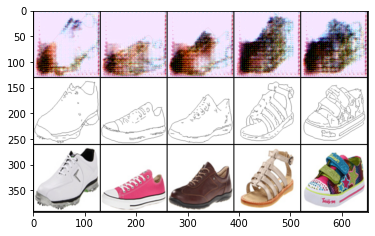

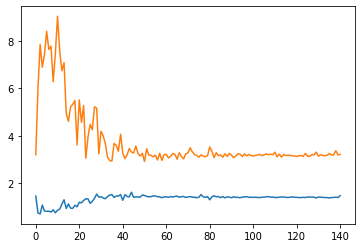

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 100, loss_G: 3.2112977504730225, loss_D: 1.4695014953613281


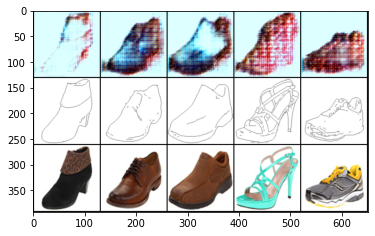

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 150, loss_G: 3.2608251571655273, loss_D: 1.4136124849319458


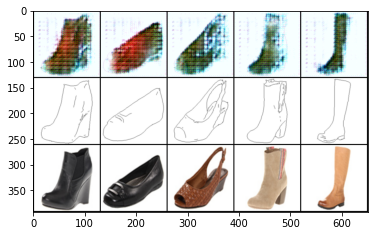

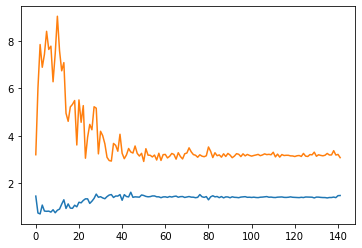

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 200, loss_G: 3.074946403503418, loss_D: 1.4766578674316406


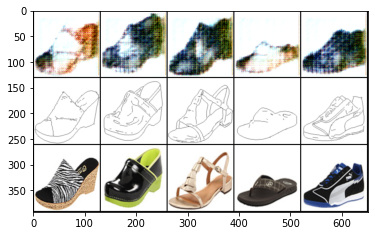

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 250, loss_G: 3.2235536575317383, loss_D: 1.4130892753601074


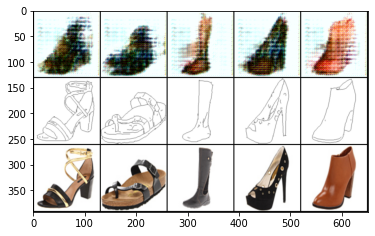

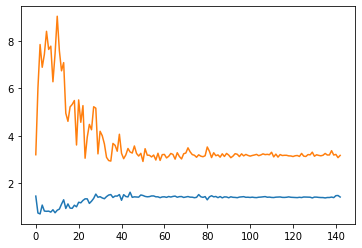

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 300, loss_G: 3.1697375774383545, loss_D: 1.4122581481933594


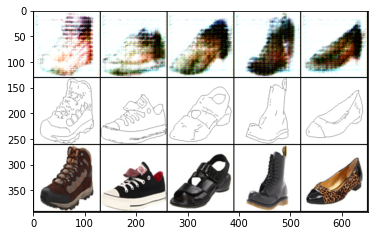

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 350, loss_G: 3.126246929168701, loss_D: 1.4039573669433594


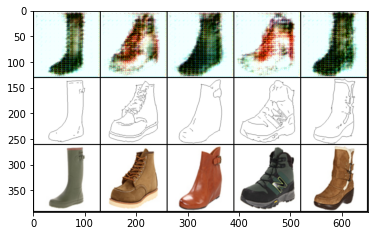

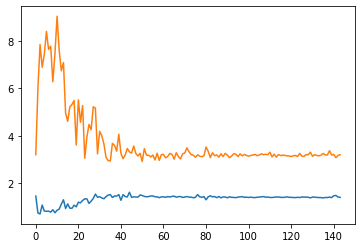

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 400, loss_G: 3.1979315280914307, loss_D: 1.398565649986267


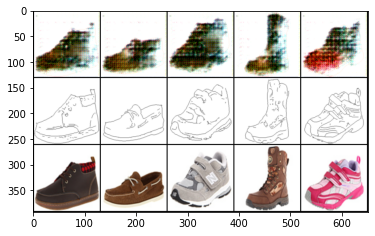

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 450, loss_G: 3.1548800468444824, loss_D: 1.421544075012207


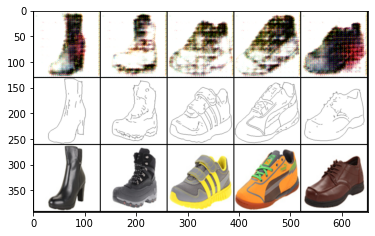

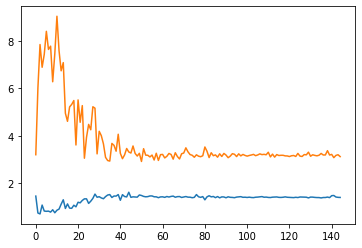

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 500, loss_G: 3.118837833404541, loss_D: 1.3945441246032715


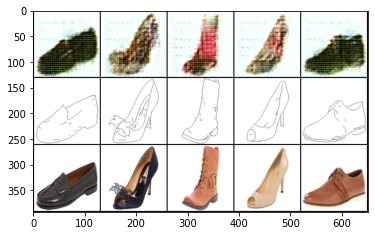

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 550, loss_G: 3.20872163772583, loss_D: 1.388561725616455


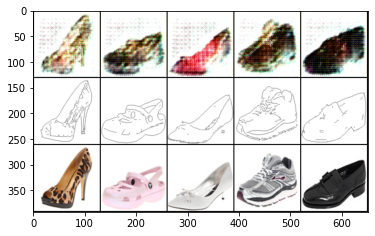

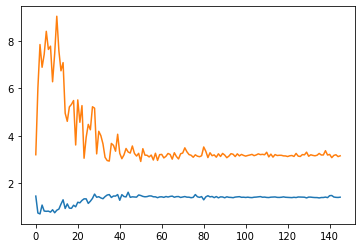

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 600, loss_G: 3.1526856422424316, loss_D: 1.4053966999053955


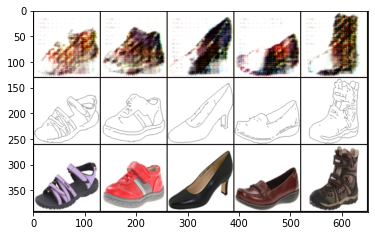

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 650, loss_G: 3.1904006004333496, loss_D: 1.401207685470581


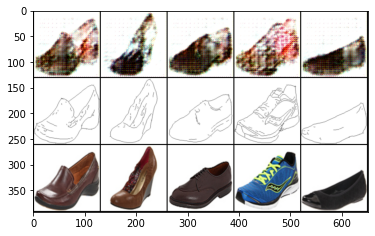

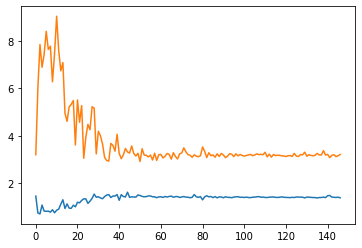

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 700, loss_G: 3.2080421447753906, loss_D: 1.3798813819885254


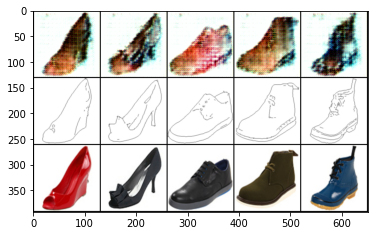

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 750, loss_G: 3.210723400115967, loss_D: 1.4060986042022705


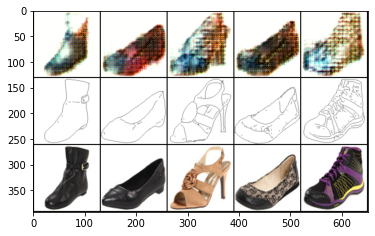

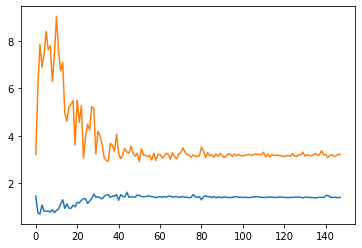

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 800, loss_G: 3.2160651683807373, loss_D: 1.4069006443023682


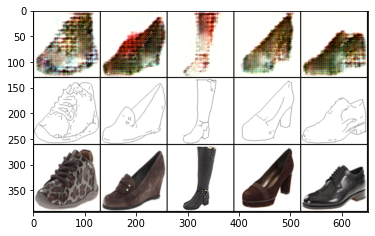

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 850, loss_G: 3.107194185256958, loss_D: 1.4039318561553955


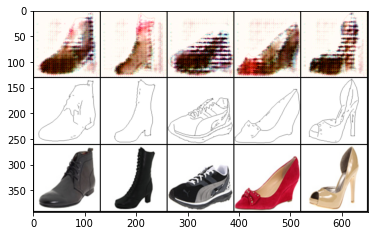

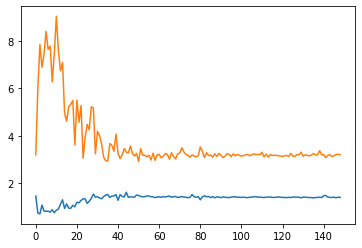

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 900, loss_G: 3.201458692550659, loss_D: 1.3964346647262573


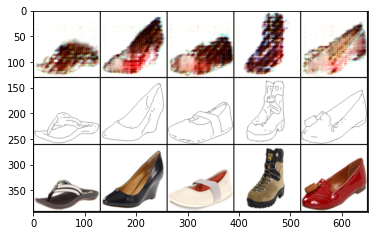

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 950, loss_G: 3.217170476913452, loss_D: 1.4155250787734985


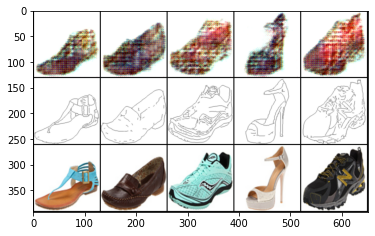

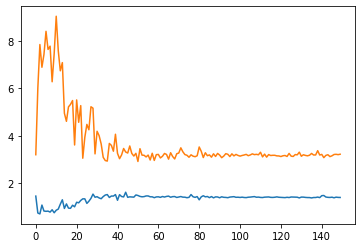

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1000, loss_G: 3.2198657989501953, loss_D: 1.3936882019042969


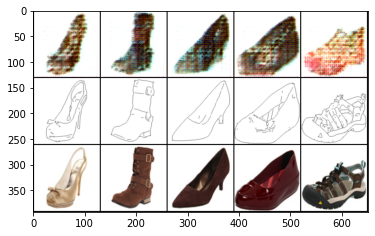

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1050, loss_G: 3.172027111053467, loss_D: 1.3979270458221436


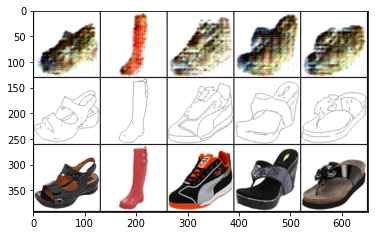

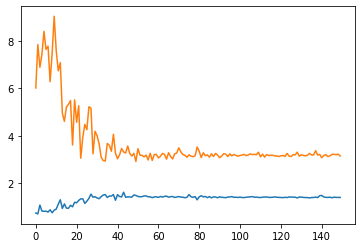

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1100, loss_G: 3.1464004516601562, loss_D: 1.394904375076294


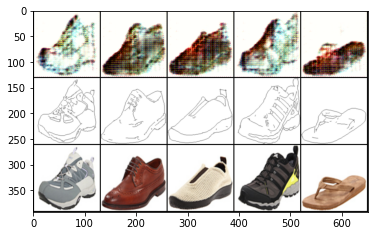

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1150, loss_G: 3.1522388458251953, loss_D: 1.3796223402023315


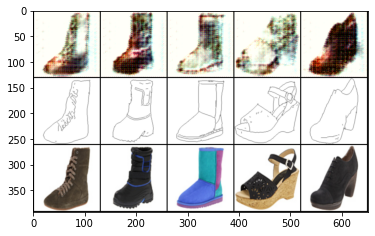

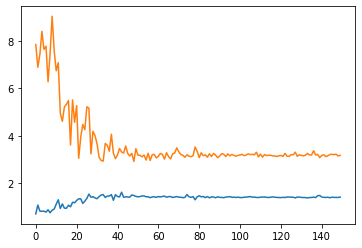

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1200, loss_G: 3.1721034049987793, loss_D: 1.4079790115356445


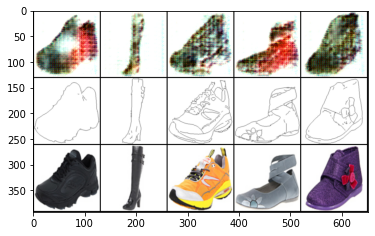

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1250, loss_G: 3.1644134521484375, loss_D: 1.3938058614730835


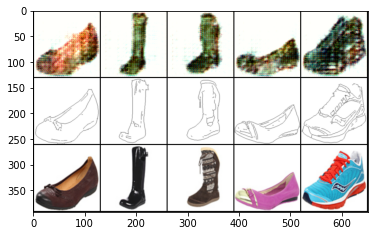

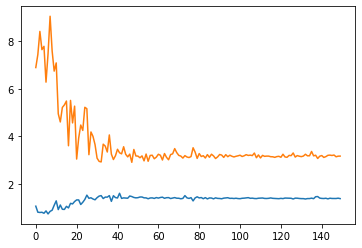

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1300, loss_G: 3.174776077270508, loss_D: 1.390741229057312


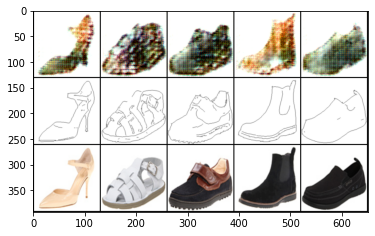

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1350, loss_G: 3.1920032501220703, loss_D: 1.3910574913024902


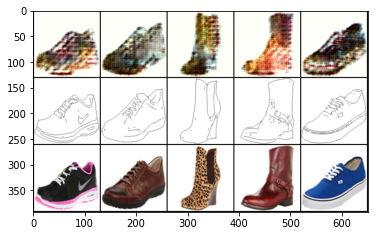

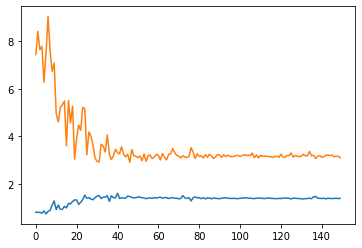

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1400, loss_G: 3.103084087371826, loss_D: 1.4024043083190918


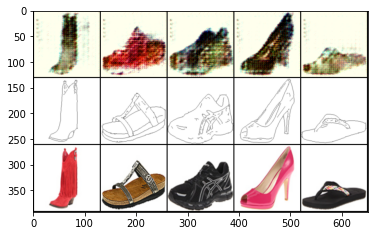

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1450, loss_G: 3.1827187538146973, loss_D: 1.3954797983169556


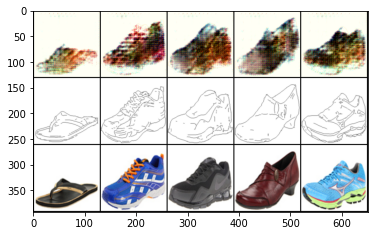

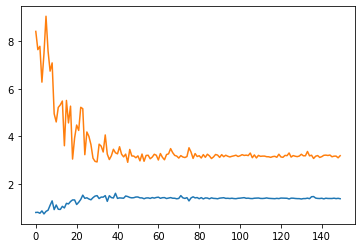

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1500, loss_G: 3.1914782524108887, loss_D: 1.3862777948379517


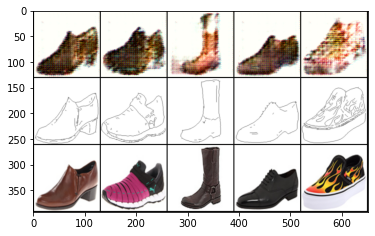

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 6, iter: 1550, loss_G: 3.2338461875915527, loss_D: 1.3978962898254395


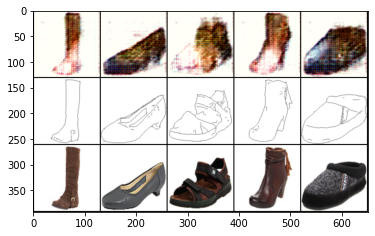

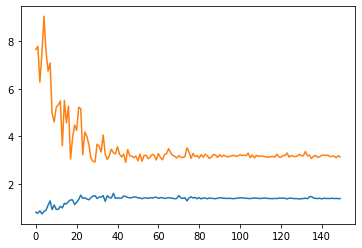

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 0, loss_G: 3.1408586502075195, loss_D: 1.3949602842330933


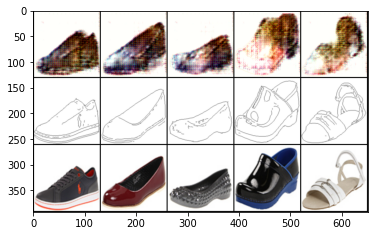

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 50, loss_G: 3.160372018814087, loss_D: 1.393836498260498


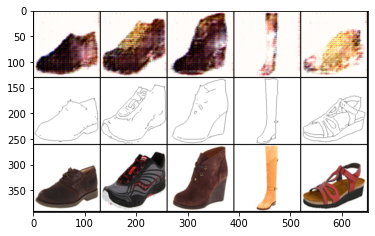

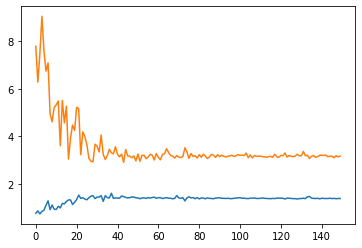

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 100, loss_G: 3.176470994949341, loss_D: 1.394066572189331


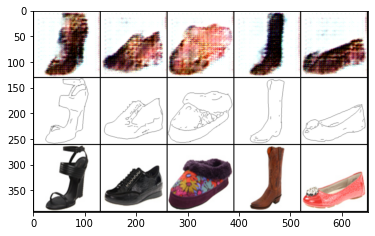

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 150, loss_G: 3.188054084777832, loss_D: 1.3926331996917725


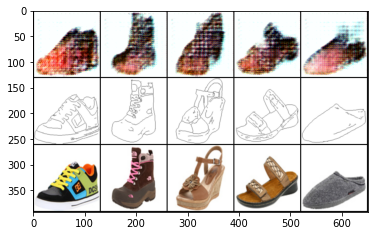

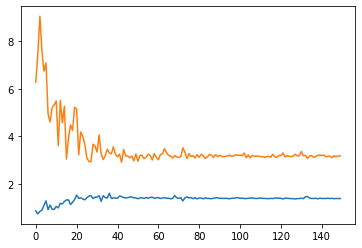

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 200, loss_G: 3.182392120361328, loss_D: 1.3934483528137207


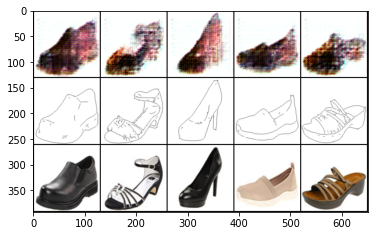

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 250, loss_G: 3.1581099033355713, loss_D: 1.390104055404663


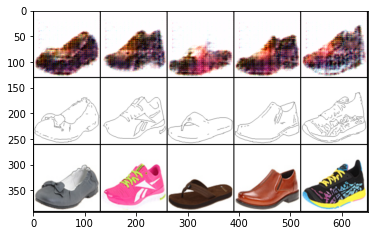

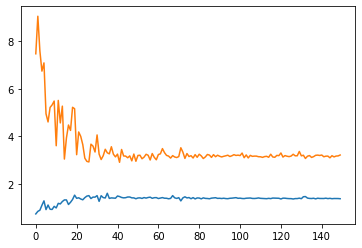

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 300, loss_G: 3.220729112625122, loss_D: 1.3863445520401


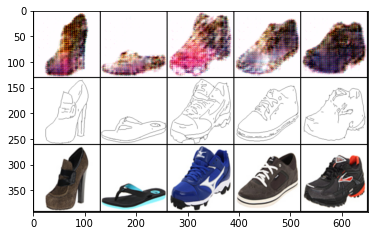

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 350, loss_G: 3.224886894226074, loss_D: 1.4039056301116943


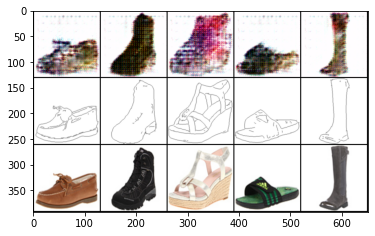

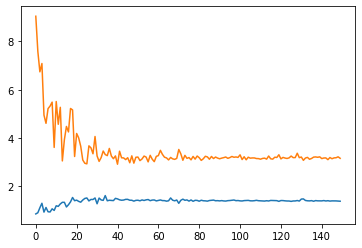

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 400, loss_G: 3.159348487854004, loss_D: 1.3810096979141235


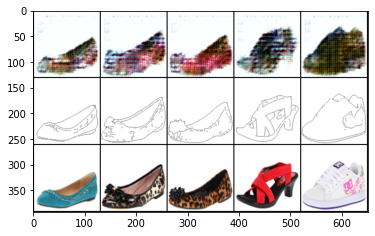

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 450, loss_G: 3.211138963699341, loss_D: 1.3908607959747314


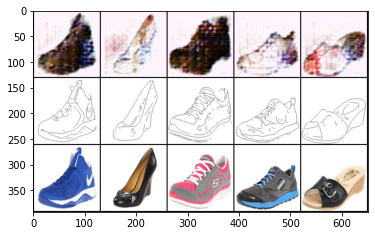

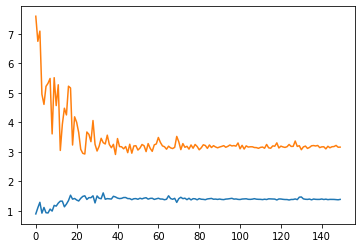

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 500, loss_G: 3.1628541946411133, loss_D: 1.3941638469696045


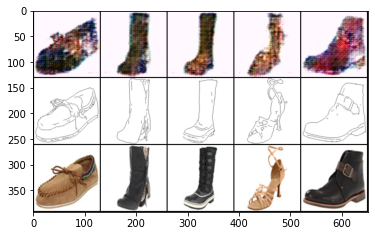

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 550, loss_G: 3.1330227851867676, loss_D: 1.3981757164001465


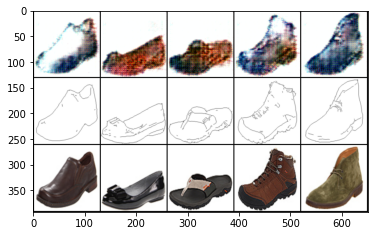

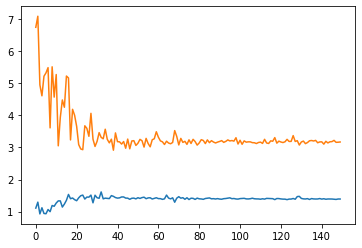

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 600, loss_G: 3.1700713634490967, loss_D: 1.3935604095458984


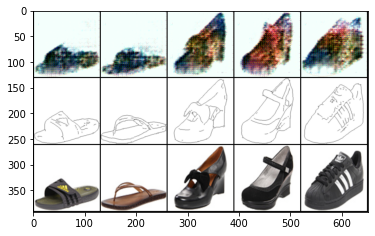

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 650, loss_G: 3.205932378768921, loss_D: 1.3889849185943604


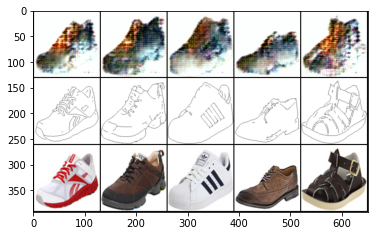

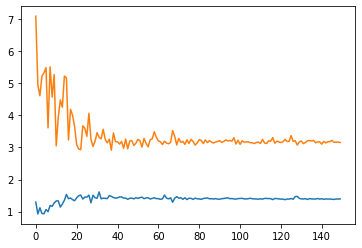

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 700, loss_G: 3.1533448696136475, loss_D: 1.3969712257385254


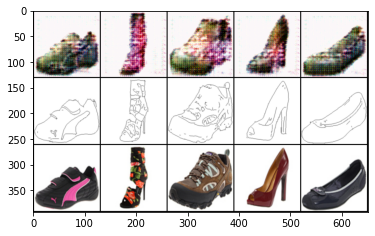

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 750, loss_G: 3.2223472595214844, loss_D: 1.388443946838379


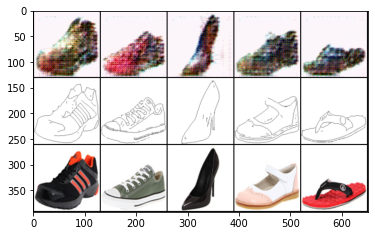

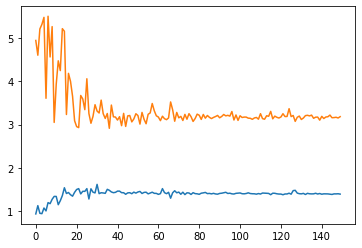

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 800, loss_G: 3.1835789680480957, loss_D: 1.388617992401123


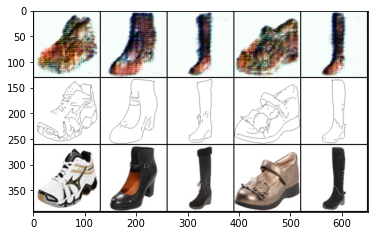

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 850, loss_G: 3.196035385131836, loss_D: 1.3983498811721802


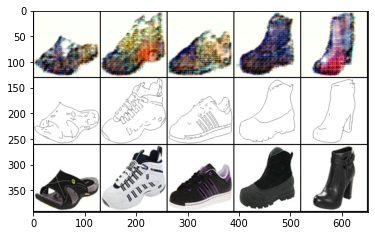

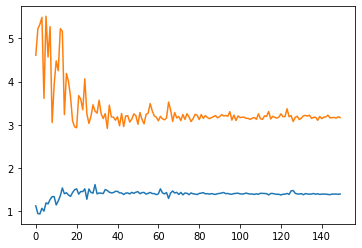

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 900, loss_G: 3.1686277389526367, loss_D: 1.3958957195281982


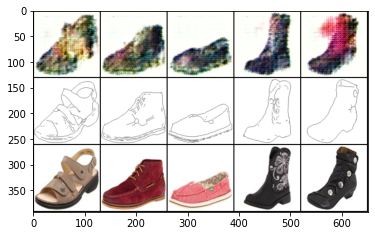

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 950, loss_G: 3.2407729625701904, loss_D: 1.3893845081329346


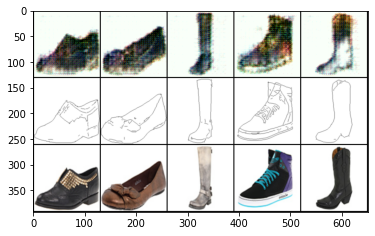

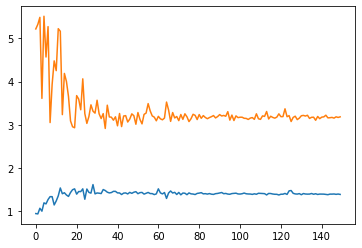

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1000, loss_G: 3.1829118728637695, loss_D: 1.3869688510894775


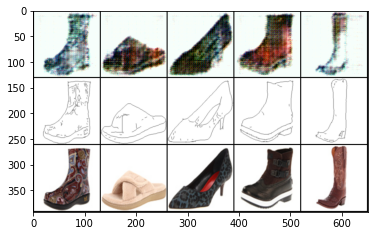

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1050, loss_G: 3.145449161529541, loss_D: 1.3942551612854004


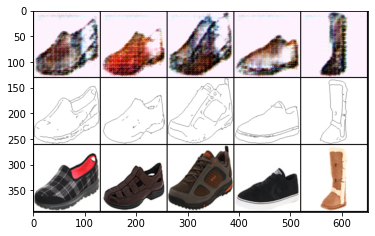

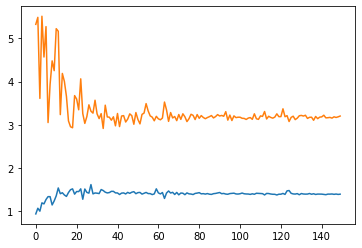

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1100, loss_G: 3.201422929763794, loss_D: 1.392725944519043


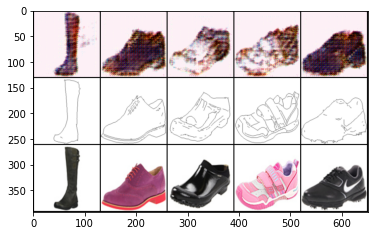

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1150, loss_G: 3.2119059562683105, loss_D: 1.392365574836731


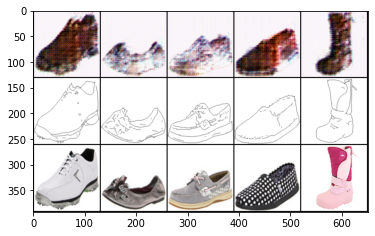

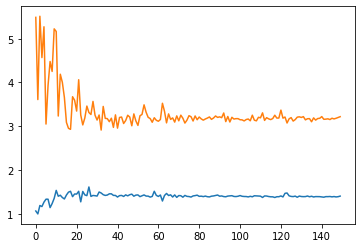

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1200, loss_G: 3.2187113761901855, loss_D: 1.405875563621521


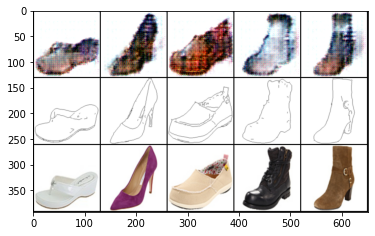

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1250, loss_G: 3.151317596435547, loss_D: 1.3893287181854248


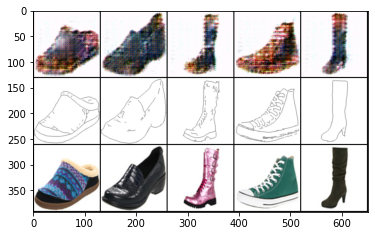

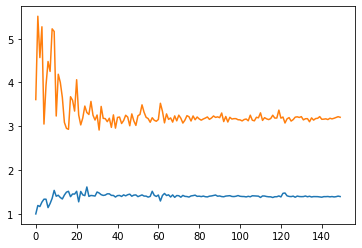

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1300, loss_G: 3.205348014831543, loss_D: 1.3957798480987549


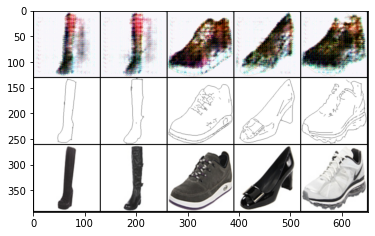

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1350, loss_G: 3.1251869201660156, loss_D: 1.401386022567749


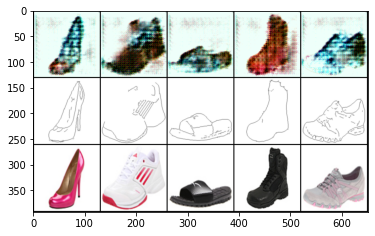

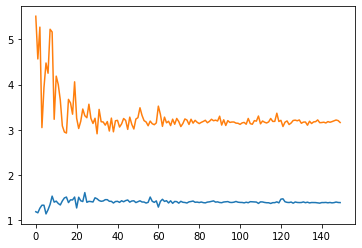

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1400, loss_G: 3.163701295852661, loss_D: 1.3933391571044922


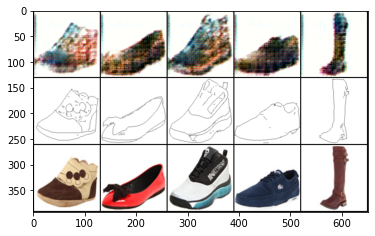

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1450, loss_G: 3.1776552200317383, loss_D: 1.3897801637649536


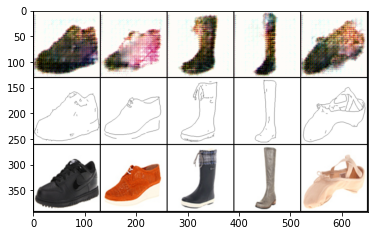

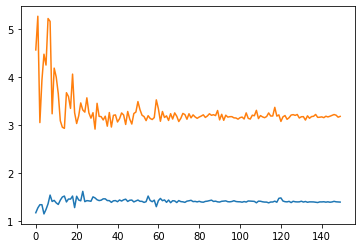

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1500, loss_G: 3.1799020767211914, loss_D: 1.390059471130371


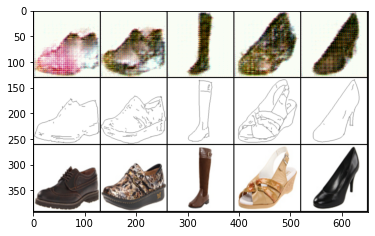

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 7, iter: 1550, loss_G: 3.2241740226745605, loss_D: 1.3877110481262207


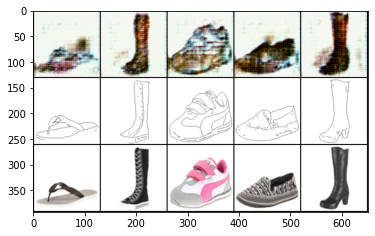

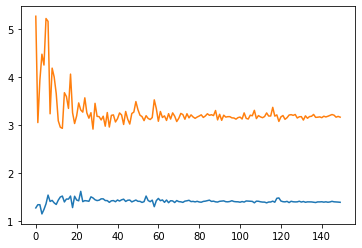

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 0, loss_G: 3.1636807918548584, loss_D: 1.3859338760375977


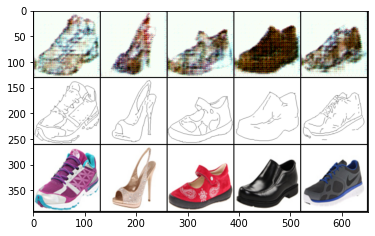

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 50, loss_G: 3.1805901527404785, loss_D: 1.3949425220489502


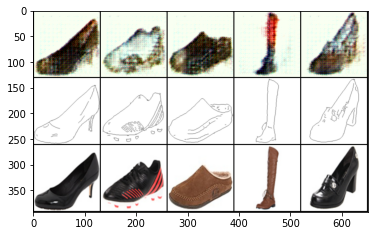

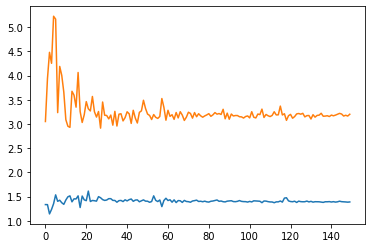

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 100, loss_G: 3.2008919715881348, loss_D: 1.3902597427368164


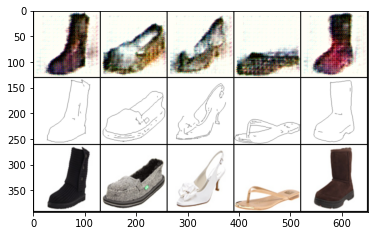

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 150, loss_G: 3.1928720474243164, loss_D: 1.3940205574035645


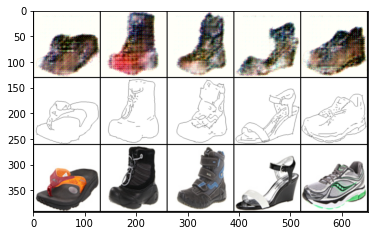

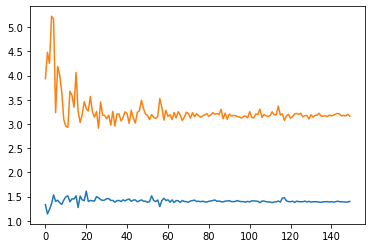

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 200, loss_G: 3.1616158485412598, loss_D: 1.4010852575302124


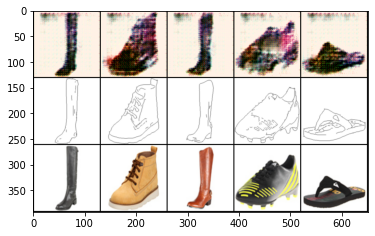

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 250, loss_G: 3.153320789337158, loss_D: 1.3953897953033447


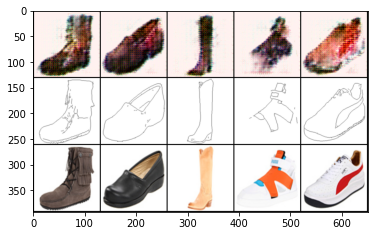

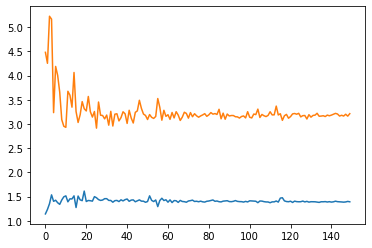

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 300, loss_G: 3.2126235961914062, loss_D: 1.3933124542236328


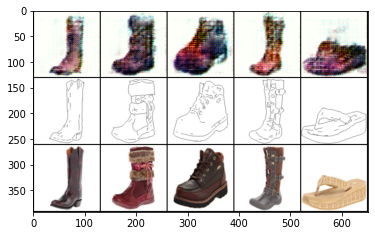

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 350, loss_G: 3.1548759937286377, loss_D: 1.385497808456421


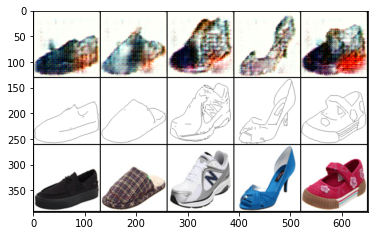

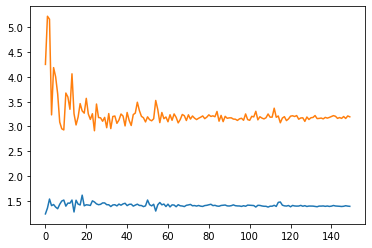

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 400, loss_G: 3.1946210861206055, loss_D: 1.3892011642456055


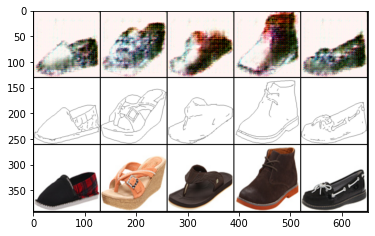

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 450, loss_G: 3.1831250190734863, loss_D: 1.3965164422988892


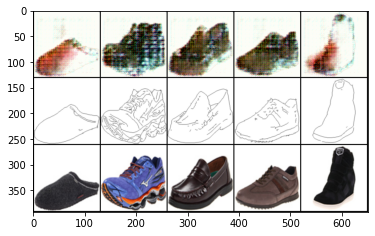

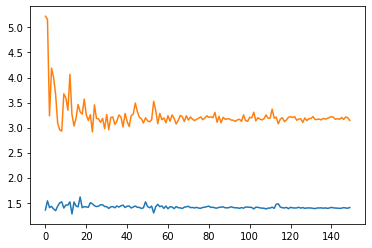

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 500, loss_G: 3.141902446746826, loss_D: 1.4030430316925049


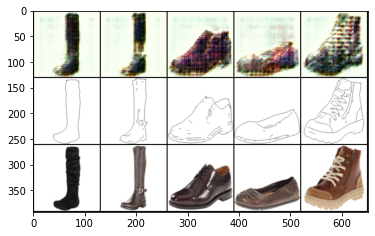

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 550, loss_G: 3.151526689529419, loss_D: 1.3817453384399414


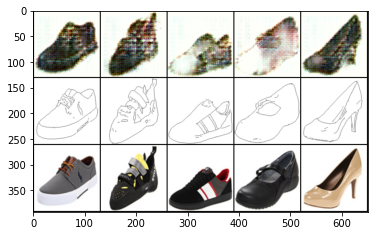

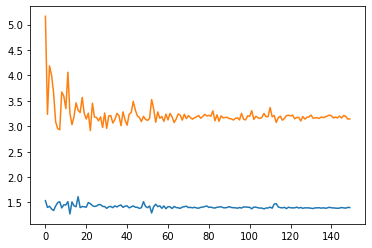

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 600, loss_G: 3.1447107791900635, loss_D: 1.4004234075546265


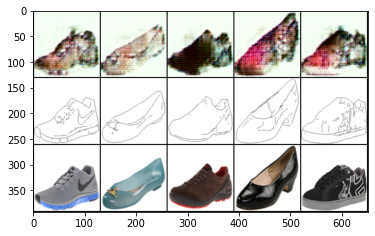

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 650, loss_G: 3.1962945461273193, loss_D: 1.3951432704925537


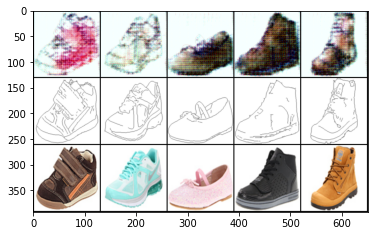

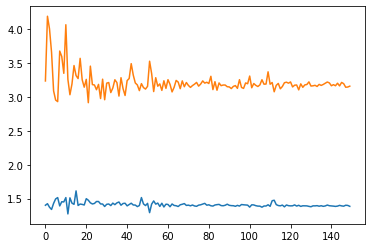

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 700, loss_G: 3.1576502323150635, loss_D: 1.387103796005249


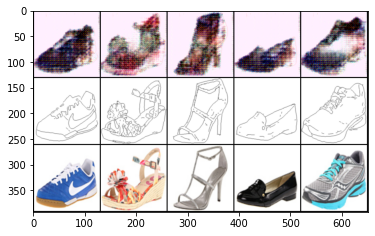

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 750, loss_G: 3.2149932384490967, loss_D: 1.3823033571243286


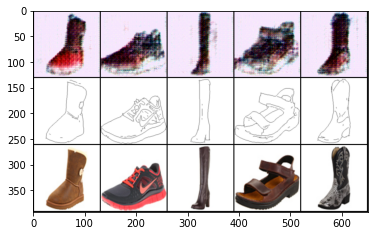

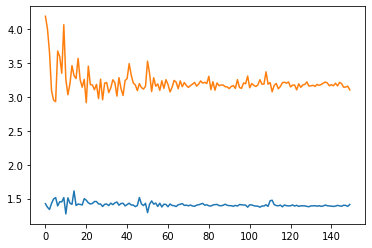

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 800, loss_G: 3.102539300918579, loss_D: 1.4143260717391968


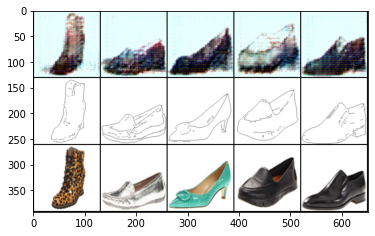

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 850, loss_G: 3.1833486557006836, loss_D: 1.4124770164489746


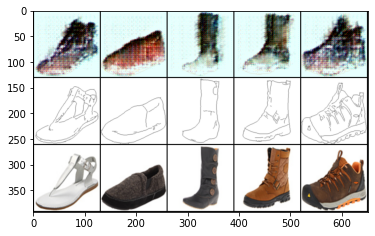

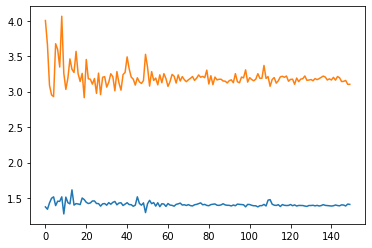

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 900, loss_G: 3.102926254272461, loss_D: 1.4089558124542236


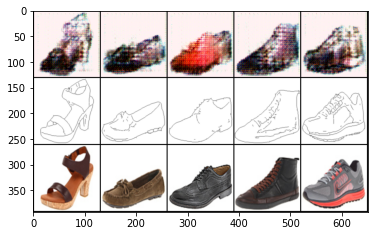

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 950, loss_G: 3.159640312194824, loss_D: 1.3966362476348877


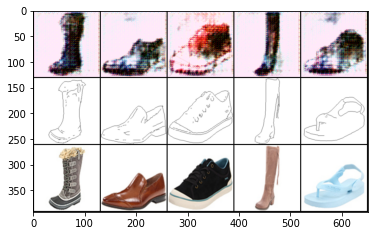

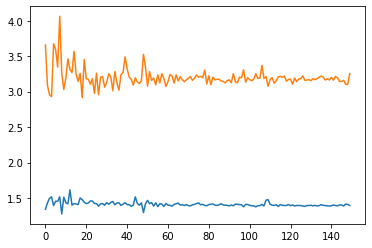

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1000, loss_G: 3.255044460296631, loss_D: 1.3936922550201416


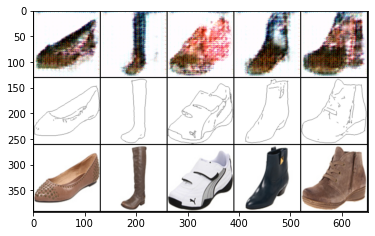

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1050, loss_G: 3.2903945446014404, loss_D: 1.3804560899734497


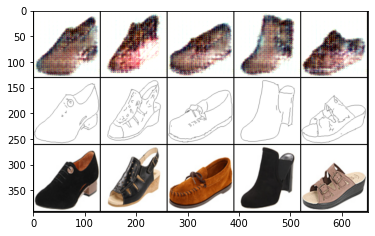

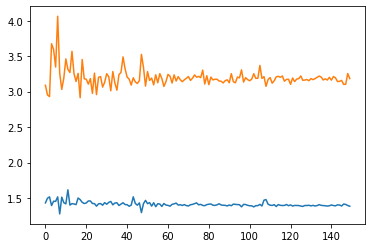

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1100, loss_G: 3.183332920074463, loss_D: 1.383590579032898


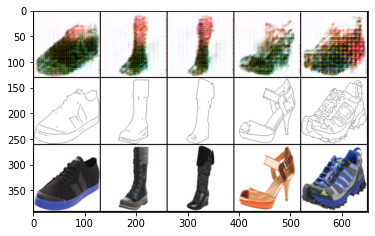

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1150, loss_G: 3.07595157623291, loss_D: 1.3993639945983887


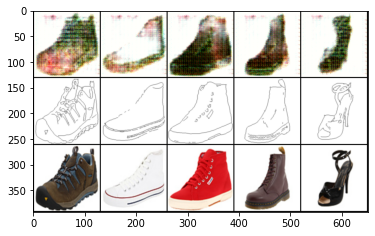

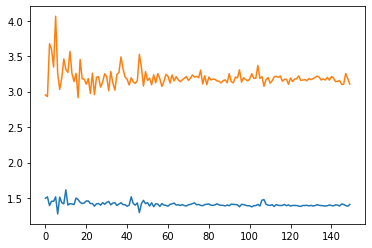

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1200, loss_G: 3.1060805320739746, loss_D: 1.408581018447876


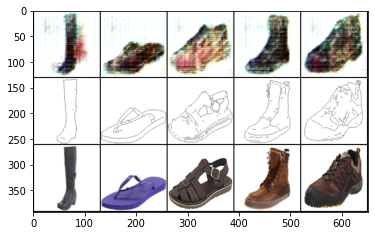

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1250, loss_G: 3.154587745666504, loss_D: 1.4032211303710938


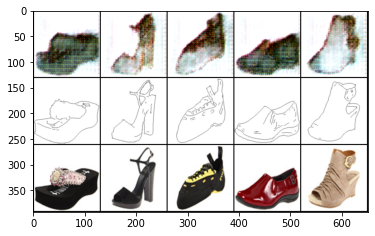

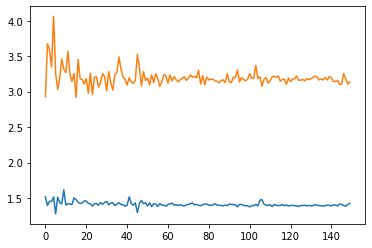

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1300, loss_G: 3.135955810546875, loss_D: 1.422776460647583


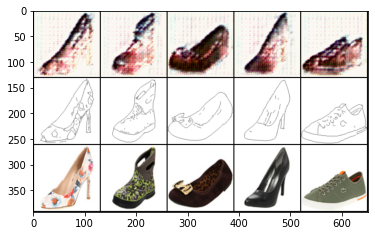

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1350, loss_G: 3.227252960205078, loss_D: 1.4186280965805054


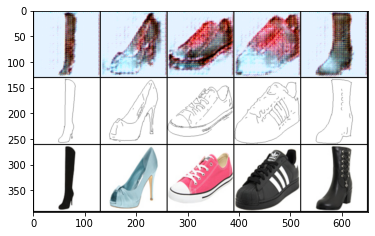

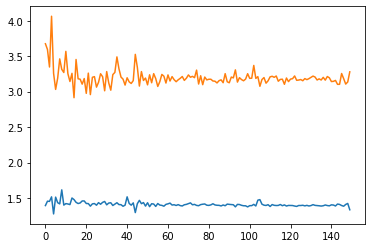

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1400, loss_G: 3.2787599563598633, loss_D: 1.3336689472198486


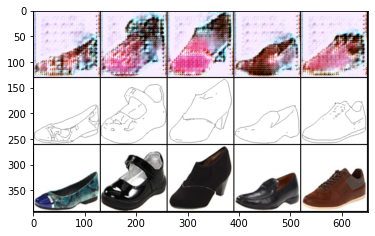

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1450, loss_G: 3.2358579635620117, loss_D: 1.437269926071167


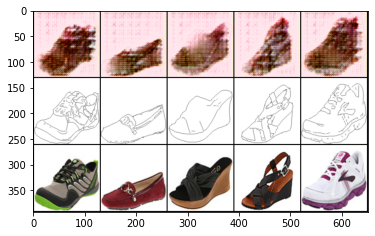

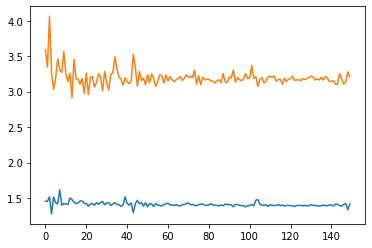

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1500, loss_G: 3.2114861011505127, loss_D: 1.4144394397735596


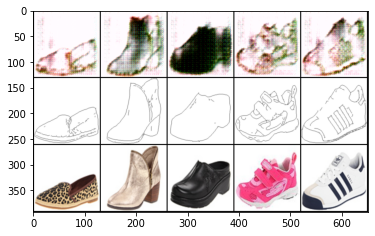

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 8, iter: 1550, loss_G: 3.303194761276245, loss_D: 1.4029680490493774


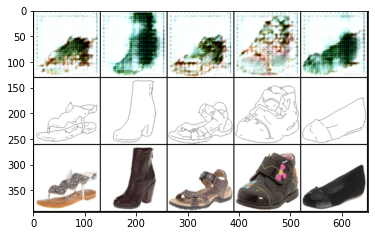

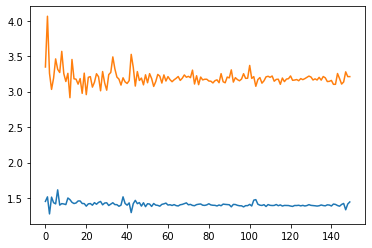

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 0, loss_G: 3.211379051208496, loss_D: 1.4438905715942383


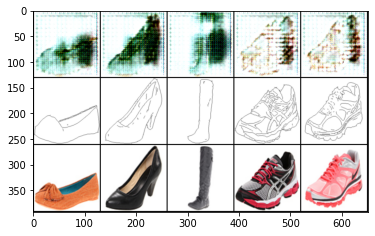

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 50, loss_G: 3.1175403594970703, loss_D: 1.4684088230133057


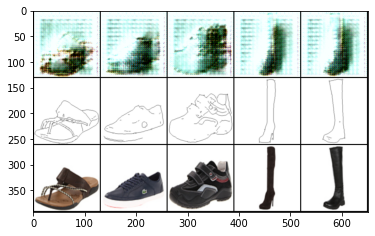

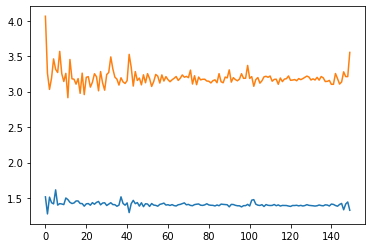

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 100, loss_G: 3.552676200866699, loss_D: 1.3266843557357788


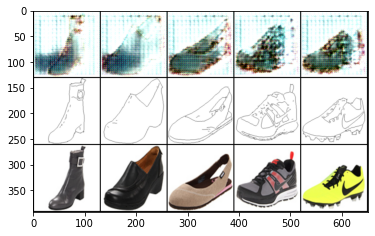

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 150, loss_G: 3.173466682434082, loss_D: 1.4888728857040405


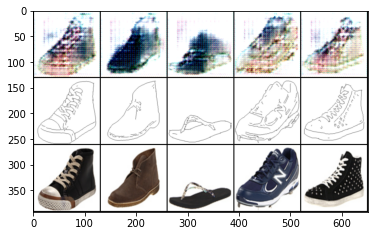

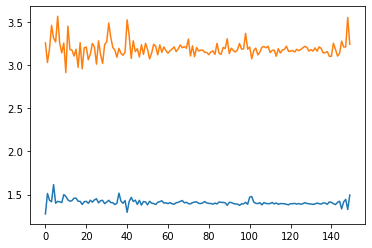

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 200, loss_G: 3.242154359817505, loss_D: 1.4939165115356445


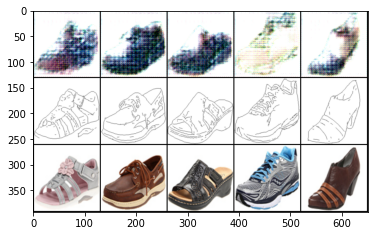

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 250, loss_G: 3.051650047302246, loss_D: 1.5125629901885986


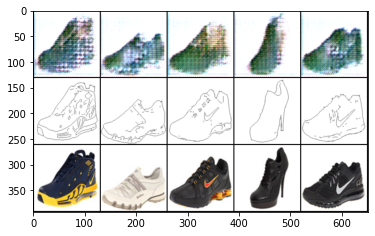

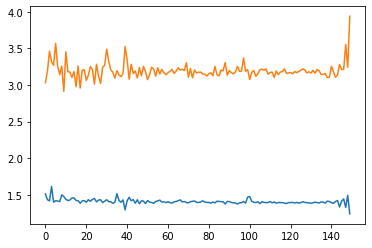

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 300, loss_G: 3.9383704662323, loss_D: 1.2394758462905884


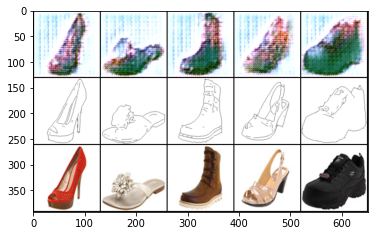

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 350, loss_G: 3.565014362335205, loss_D: 1.2897069454193115


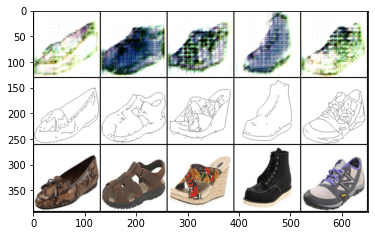

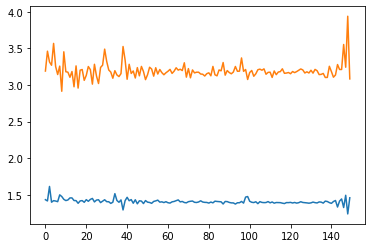

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 400, loss_G: 3.0828819274902344, loss_D: 1.4598305225372314


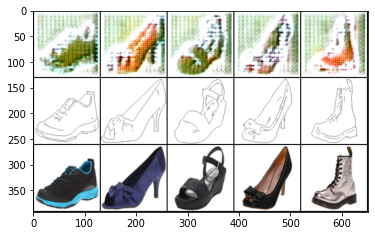

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 450, loss_G: 3.3143317699432373, loss_D: 1.388657808303833


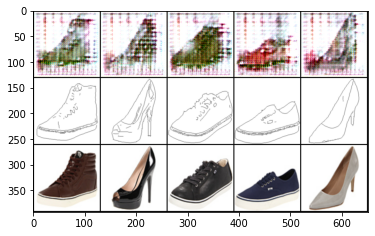

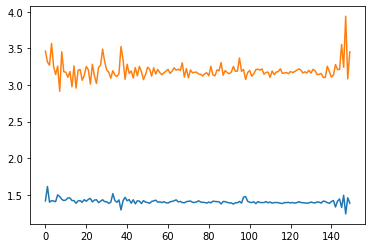

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 500, loss_G: 3.452826976776123, loss_D: 1.3867912292480469


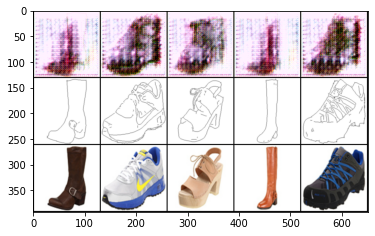

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 550, loss_G: 3.1728382110595703, loss_D: 1.3830511569976807


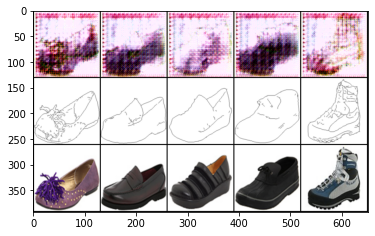

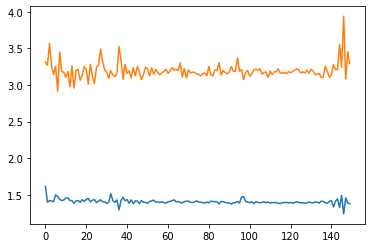

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 600, loss_G: 3.290491819381714, loss_D: 1.3775004148483276


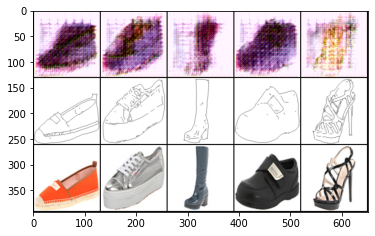

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 650, loss_G: 3.4297609329223633, loss_D: 1.383475661277771


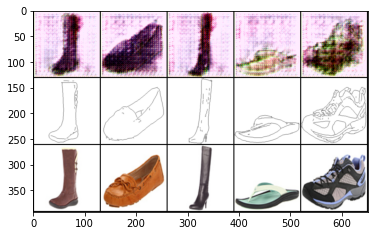

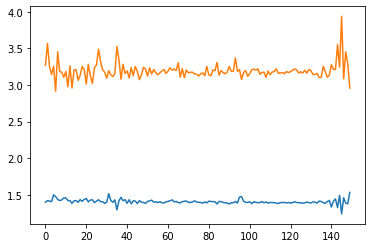

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 700, loss_G: 2.958254337310791, loss_D: 1.5330684185028076


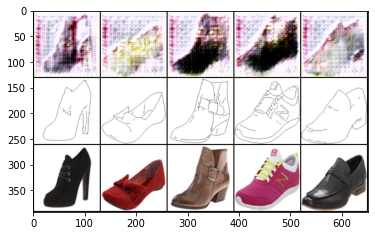

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 750, loss_G: 3.2117507457733154, loss_D: 1.4083956480026245


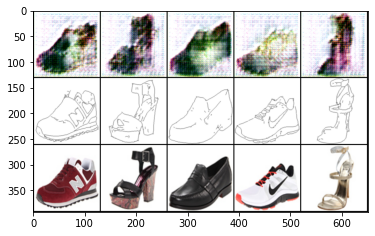

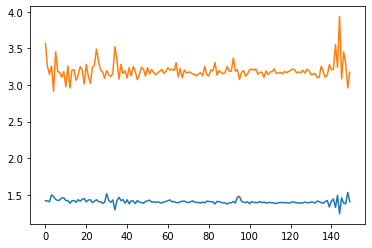

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 800, loss_G: 3.173815965652466, loss_D: 1.4057731628417969


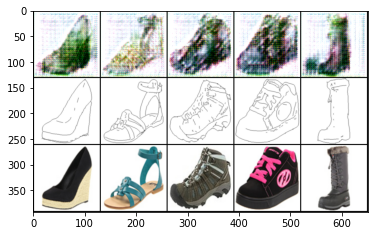

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 850, loss_G: 3.181015968322754, loss_D: 1.401883840560913


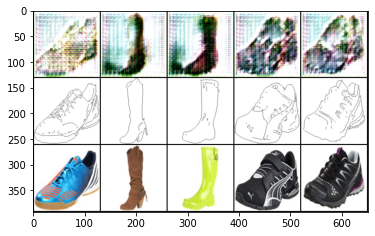

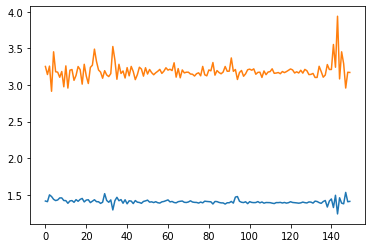

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 900, loss_G: 3.1709115505218506, loss_D: 1.4103741645812988


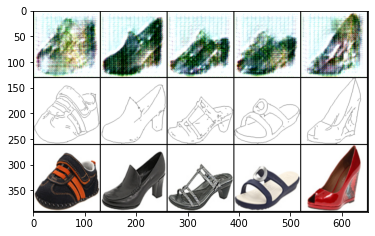

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 950, loss_G: 3.2311644554138184, loss_D: 1.3904345035552979


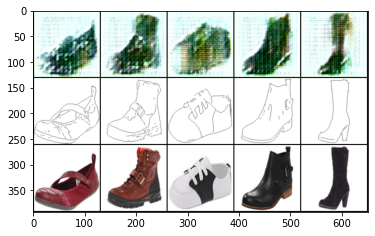

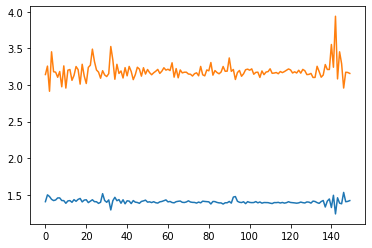

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1000, loss_G: 3.1577296257019043, loss_D: 1.421457052230835


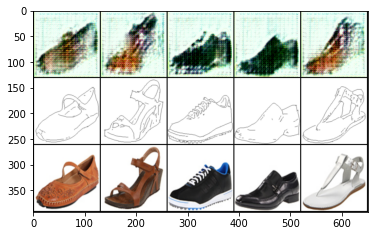

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1050, loss_G: 3.171506404876709, loss_D: 1.4005084037780762


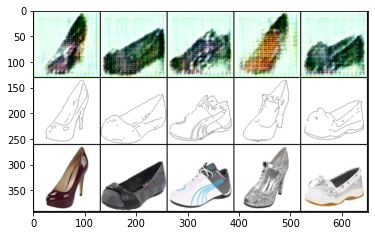

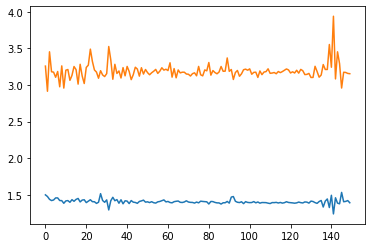

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1100, loss_G: 3.1539125442504883, loss_D: 1.3917996883392334


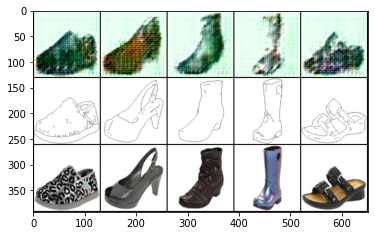

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1150, loss_G: 3.1730904579162598, loss_D: 1.3960140943527222


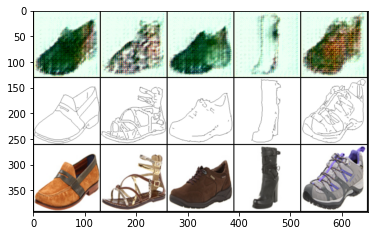

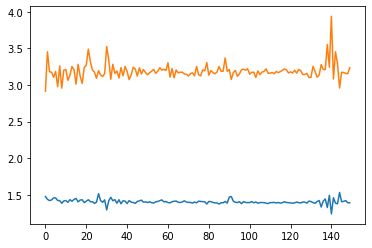

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1200, loss_G: 3.2361268997192383, loss_D: 1.3921971321105957


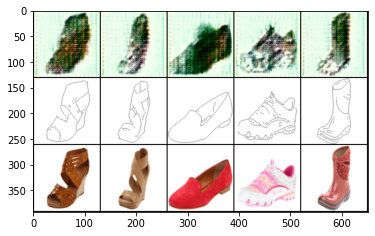

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1250, loss_G: 3.1904470920562744, loss_D: 1.4108011722564697


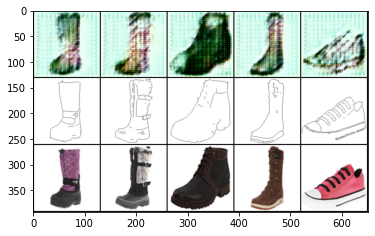

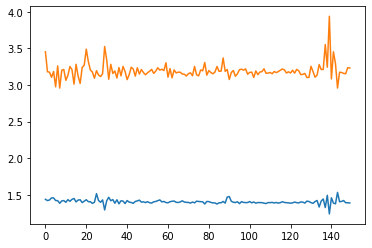

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1300, loss_G: 3.2316136360168457, loss_D: 1.3891440629959106


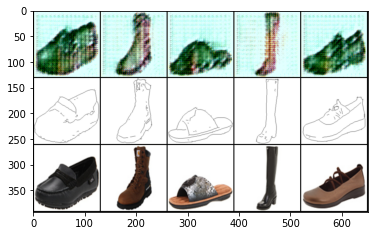

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1350, loss_G: 3.159329891204834, loss_D: 1.400338888168335


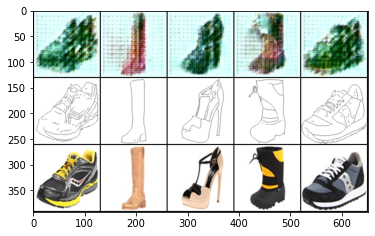

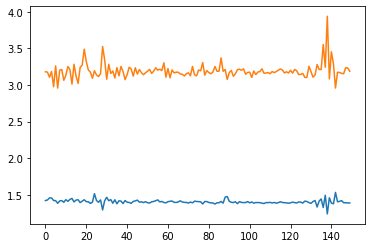

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1400, loss_G: 3.1874022483825684, loss_D: 1.3892791271209717


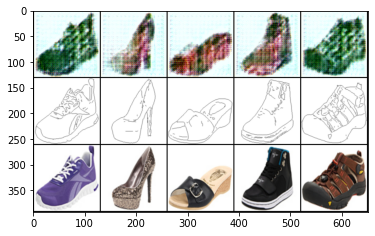

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1450, loss_G: 3.2038748264312744, loss_D: 1.3788297176361084


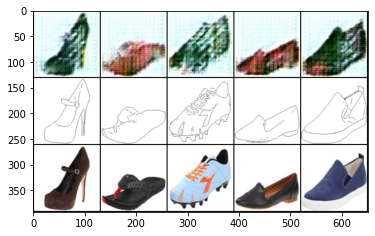

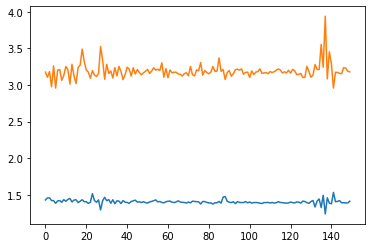

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1500, loss_G: 3.178598642349243, loss_D: 1.4127193689346313


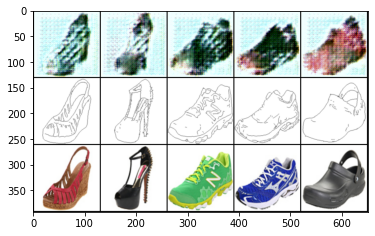

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 9, iter: 1550, loss_G: 3.2023110389709473, loss_D: 1.3883610963821411


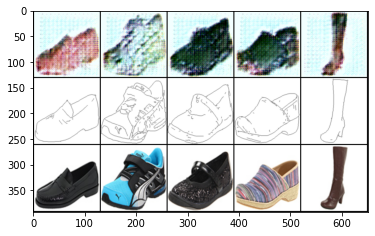

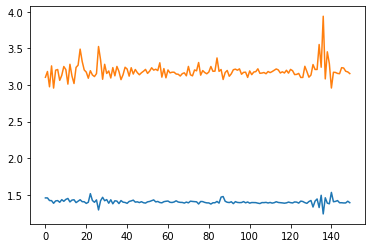

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 10, iter: 0, loss_G: 3.155648708343506, loss_D: 1.3926727771759033


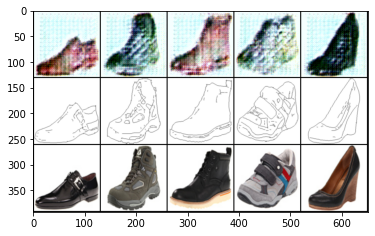

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch: 10, iter: 50, loss_G: 3.190783977508545, loss_D: 1.3808684349060059


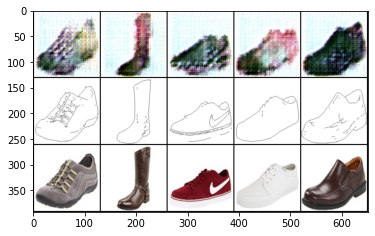

In [0]:
#G(x,z), D(x,y)
factor=2
G.train()
D.train()
for epoch in range(70):
  for i,(x,y) in enumerate(dataloader):
    opt_D.zero_grad()
    opt_G.zero_grad()

    x=x.to(device)
    y=y.to(device)
    if i%factor==0:
      #train Discriminator
      #1. for real data
      loss_real=criterion_D(D(x,y),torch.ones((batch_size,)).to(device)*0.9)

      z=torch.randn((batch_size,1,128,128)).to(device)
      loss_fake=criterion_D(D(x,G(x,z).detach()),torch.ones((batch_size,)).to(device)*0.1)

      loss_D=loss_real+loss_fake
      loss_D.backward()
      opt_D.step()

    #train Generator
    z=torch.randn((batch_size,1,128,128)).to(device)
    loss_G=criterion_G(D(x,G(x,z)),torch.ones((batch_size,)).to(device))
    loss_G.backward()
    opt_G.step()


    if i%100==0:
      losses_D.append(loss_D.data)
      losses_G.append(loss_G.data)

    if i%100==0:
      plt.figure()
      plt.plot(losses_D[-150:])
      plt.plot(losses_G[-150:])
      plt.show()
      
      torch.save(D.state_dict(), "gdrive/My Drive/pix2pixmodel/D_changed_loss.pth")
      torch.save(G.state_dict(), "gdrive/My Drive/pix2pixmodel/G_changed_loss.pth")
      np.save('gdrive/My Drive/pix2pixmodel/Losses_G_changed_loss.npy',losses_G)
      np.save('gdrive/My Drive/pix2pixmodel/Losses_D_changed_loss.npy',losses_D)


    if i%50==0:
      print(f'epoch: {epoch}, iter: {i}, loss_G: {loss_G}, loss_D: {loss_D}')
      generated_imgs=G(x[:5],z[:5])
      real_imgs=x[:5]
      imgs=torch.cat([generated_imgs,real_imgs,y[:5]],0).data.cpu()
      grid=make_grid(imgs,nrow=5).permute(1,2,0).numpy()
      plt.imshow(grid)
      plt.show()
